In [1]:
from IPython import get_ipython
%load_ext autoreload
%autoreload 2

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

In [2]:
# %matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import sys
import os
import time
os.environ['HF_HOME'] = '/raid/xd/.cache/torch' # mqy
from types import MethodType
from tqdm import tqdm
from collections import defaultdict, OrderedDict, Counter, namedtuple
from datetime import datetime
from io import StringIO
from itertools import chain, product, combinations, cycle
import math
from functools import reduce, partial
from collections.abc import Iterable
import pickle, gzip

import numpy as np
import pandas as pd
from scipy.stats.stats import pearsonr

from sklearn.manifold import TSNE, MDS
from sklearn.decomposition import PCA
import einops
from einops import rearrange

In [3]:
# import transformers; transformers

In [4]:
import torch
import torch.nn as nn
from torch.nn import BCEWithLogitsLoss, CrossEntropyLoss
import torch.nn.functional as F 
from torch.utils.data.sampler import RandomSampler, Sampler, SequentialSampler
from torch.utils.data.dataloader import DataLoader
import torch.optim as optim

# sys.path.insert(0, '/nas/xd/projects/transformers/src')
# from transformers.data.data_collator import DataCollator, default_data_collator
from transformers import AutoConfig, AutoModelForCausalLM, AutoTokenizer, pipeline
from transformers import RobertaForMaskedLM, RobertaTokenizer, GPT2LMHeadModel, GPT2Tokenizer, GPTNeoForCausalLM
from transformers import T5Tokenizer, T5ForConditionalGeneration

from transformers.models.gpt2.modeling_gpt2 import GPT2Attention
from transformers.models.gpt_neo.modeling_gpt_neo import GPTNeoSelfAttention
from transformers.models.gptj.modeling_gptj import GPTJAttention, GPTJBlock
from transformers.models.xglm.modeling_xglm import XGLMAttention

# from transformers import HfArgumentParser, Trainer, TrainingArguments, set_seed
# from transformers.trainer_utils import EvaluationStrategy

In utils/hub.py: default_cache_path: /raid/xd/.cache/torch/hub->/nas/xd/.cache/torch/transformers/


In [5]:
sys.path.insert(0, '/nas/xd/projects/pptree')
from pptree import Node, print_tree

In [6]:
from child_utils import *
from common_utils import *
from model_utils import *
from weight_analysis_mqy import *

In const.py: Loading tokenizer ... done 0:00:00.663060


In [7]:
torch.set_grad_enabled(False);

In [8]:
!pwd

/nas/xd/projects/transformers/notebooks


In [9]:
models = {}
cache_dir = '/nas/xd/.cache/torch/transformers/'  # for models besides t5-3b/11b
proxies = {'http': '192.168.50.1:1081'} 

In [385]:
# model_name = "EleutherAI/gpt-neo-1.3B"
for model_name in [
            'EleutherAI/gpt-j-6B/cpu',
            'gpt2-medium/cpu',
#             'gpt2-large', 
#             'gpt2-xl', 'EleutherAI/gpt-neo-1.3B',  # = babbage
#             'EleutherAI/gpt-j-6B', 'KoboldAI/fairseq-dense-6.7B', # = curie 
#             'KoboldAI/fairseq-dense-13B'
            ]:
    print('cache_dir', cache_dir)
    if model_name not in models:
        with Timer(model_name):
            model = AutoModelForCausalLM.from_pretrained(model_name.replace('/cpu',''), cache_dir=cache_dir)  
            tokenizer = AutoTokenizer.from_pretrained(model_name.replace('/cpu',''), cache_dir=cache_dir)
            models[model_name] = model, tokenizer

In const.py: Loading tokenizer ... done 0:00:00.304036
cache_dir /nas/xd/.cache/torch/transformers/
cache_dir /nas/xd/.cache/torch/transformers/
gpt2-medium/cpu ... done 0:00:24.533073


In [437]:
# model_name = 'gpt2-large'  # medium / large /xl
# model_name = 'gpt2-medium/cpu'
model_name = 'EleutherAI/gpt-j-6B/cpu' # gpt-j-6B, gpt-neo-1.3B/2.7B
model, tokenizer = models[model_name]
_ = model.eval()

masked_lm = tokenizer.mask_token is not None and len(tokenizer.additional_special_tokens) == 0
if masked_lm:
    mask_token = tokenizer.mask_token  # '<mask>' for roberta
elif len(tokenizer.additional_special_tokens) > 0:
    mask_token = tokenizer.additional_special_tokens[0]  # '<extra_id_0>' for t5
else:
    mask_token = ''  # for gpt2
if masked_lm: nlp = pipeline('fill-mask', model=model, tokenizer=tokenizer, top_k=5)

Using mask_token, but it is not set yet.


In [ ]:
for block in model.transformer.h: _ = block.attn.to('cuda')

In [ ]:
for block in model.transformer.h: _ = block.attn.to('cpu')
torch.cuda.empty_cache()

In [438]:
unify(model)
blocks = model.transformer.h
attn0 = blocks[0].attn
ln_f = model.transformer.ln_f
L, H, embed_dim = len(blocks), attn0.num_heads, attn0.embed_dim

we = model.transformer.wte.weight.data
wu = model.lm_head.weight.data

T = we.shape[0]

es = [we]
for b in blocks[:1]: es.append(es[-1] + mlp_forward(b, es[-1]))
model.es = es

In [13]:
weBTAs = [es[i].T @ es[i] for i in range(2)]
# weBTAs = [e.to(attn0.k_proj.weight.device) for e in weBTAs]
# weBTAs = [e.to('cpu') for e in weBTAs]
model.weBTAs = weBTAs

In [ ]:
device = 'cuda'
config = model.config
for block in model.transformer.h[8:]:
    # block.ln_1_gpu = nn.LayerNorm(config.n_embd, eps=config.layer_norm_epsilon)
    # block.attn_gpu = type(block.attn)(config)
    # if my_isinstance(block.attn, GPTJAttention): # need unify for other models
    #     block.attn_gpu.num_heads = block.attn_gpu.num_attention_heads
    block.mlp_gpu = type(block.mlp)(config.n_inner if config.n_inner is not None else 4 * config.n_embd, config)
    for name in ['mlp']: # ['ln_1', 'attn']:
        _ = getattr(block, name + '_gpu').load_state_dict(getattr(block, name).state_dict())
        _ = getattr(block, name + '_gpu').to(device)
        setattr(block, name + '_cpu', getattr(block, name))
    block.ln_2_gpu, block.ln_2_cpu = block.ln_1_gpu, block.ln_1_cpu
    

In [ ]:
all_heads = list(product(range(L), range(H)))
all_heads_by_layer = [(l, None) for l in range(L)]
def heads_in_layers(layer_start, layer_stop, H=H): return list(product(range(layer_start, layer_stop), range(H)))

In [ ]:
a = o.attentions[12][0, 10]
sim = torch.einsum('lhij->lh', (torch.cat(o.attentions) + 1e-9).log() * a * torch.ones_like(a).tril())
list(zip(*topk_md(sim, 10)))

In [ ]:
l = 10
for text, examples, inputs, tokens, bos_indices, eos_indices, answers, labels, o, attn_attr in data_tuples[:1]:
    for k in range(H // 4):
        # print(layer, k * 2, k * 2 + 1)
        fig, axs = plt.subplots(1, 4, sharex=False, sharey=False, figsize=(20, 5))
        h = k * 4 + 0; plot_attn(o.attentions[l][0, h], tokens, ax=axs[0])
        h = k * 4 + 1; plot_attn(o.attentions[l][0, h], tokens, ax=axs[1])
        h = k * 4 + 2; plot_attn(o.attentions[l][0, h], tokens, ax=axs[2])
        h = k * 4 + 3; plot_attn(o.attentions[l][0, h], tokens, ax=axs[3])

## Explore GPT-J

In [14]:
import circuitsvis as cv
import plotly.express as px
from sklearn.manifold import TSNE
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [15]:
def plot_dist(data, bins=100, label=None):
    cnt, idxs = torch.histogram(data,bins=bins)
#     plt.plot(idxs[:-1], cnt, label=label)
    plt.plot(idxs[:-1]+label*0.5, cnt, label=label)

def plot_images(ims):
    fig = make_subplots(rows=1, cols=len(ims))
    for i, im in enumerate(ims): 
        fig.add_trace(go.Image(z=im[::100, ::100]), 1, i+1)
    return fig

In [16]:
# load common words
words = []
with open('google-10000-english.txt', 'r') as f:
    for l in f.readlines():
        words.append(l.replace('\n',''))
        
widxs = []
cwords = []
embs = []
# for w in words[1000:2000]:
for w in words[:10000]:
    try:
        widx = tokenizer.encode(w)[0]
        widxs.append(widx)
        cwords.append(w)
    except:
        continue
widxs = torch.tensor(widxs)
cwords = np.array(cwords)
print(len(cwords))


10000


In [17]:
print('wte', model.transformer.wte.weight.data.shape)
print('lm_head', model.lm_head.weight.data.shape)
print('ln_f: data, bias', model.transformer.ln_f.weight.data.shape, model.transformer.ln_f.bias.data.shape)
print('blocks', len(model.transformer.h))
ln_f = model.transformer.ln_f
blocks = model.transformer.h
ln_fs =  [b.ln_1 for b in model.transformer.h][::1] +[model.transformer.ln_f]
# plt.cla()
for i, lnf in enumerate(ln_fs):
    w, b = lnf.weight.data, lnf.bias.data
#     print(i, w.mean(), w.max(), w.var(), b.max(), b.mean(), b.var()) 
#     plt.plot(w[::10]+0.1*i, label=i)
#     plot_dist(w,label=i)
arrs = []
for i, b in enumerate(blocks[12:]):
#     if i > 2:
#         continue
    _arrs = (q, k, o, v) = b.attn.q_proj.weight.data, b.attn.k_proj.weight.data, b.attn.out_proj.weight.data, b.attn.v_proj.weight.data 
    arrs.append(torch.stack([v[::50,::50] for v in _arrs[:1]]))
    #     print(i, q.mean(), q.max(), q.var(), k.max(), k.mean(), k.var()) 
#     fig = plot_images(arrs)
#     fig.show()
#     px.imshow(q[::10,::10])
px.imshow(torch.cat(arrs), facet_col=0, facet_col_wrap=4)
# plt.legend()
# plt.show()
# plot_dist(ln_f.weight.data)
# block0


wte torch.Size([50400, 4096])
lm_head torch.Size([50400, 4096])
ln_f: data, bias torch.Size([4096]) torch.Size([4096])
blocks 28


In [403]:
## interpretability in embedding space
# embedding(N,e): (i, N/1) @ (N, e) --> (i,e)  input_ids @ we or we[input_ids]
# unembedding(N,e): (i, e) @ (N, e).T --> (i, N)  hidden @ Wu.T 

def get_transformations(f, e=None, qk=None, out=False, compose=False): # f: (N, 4096) --> (N, 4096)
    if qk:
      # e @ wq @ wk @ e
        A, B = e @ wq, e @ wk
        m = A @ B.T
        return m 
    else:
        if e is None:
            e1 = es[1]
        else:
            e1 = e + mlp_forward(blocks[0], e)   #e1 = e + attn_forward(blocks[0], e, e, e)[0]
        if compose:
            e_out = e1
            for _f in f:
#                 print('e_out', torch.norm(e_out, dim=1).mean())
#                 print('ov_out', torch.norm(_f(e_out), dim=1).mean())
                e_out = _f(e_out) + e_out
#             e_out = f[-1](e_out) + e_out
        else:
            e_out = f(e1)         # transform
        e_ln = ln_f(e_out)
        if out:
            return e_ln @ wu.T, e_out
        return e_ln @ wu.T
    
def get_head_qk(layer=0,head=0,weight=False):
    wq, wk, wv, wo = get_head_weights(model, layer, head, transpose=True)
    e = es[1]
    A, B = e @ wq, e @ wk
    m = A @ B.T
    if weight:
        return wq @ wk.T
    return m 

def mlp_ov_fn(layer=0, act_vec=None, norm=False):
    def fn(e):
        e = blocks[layer].ln_1(e) 
        w2, b2 = blocks[layer].mlp.fc_out.weight.data, blocks[layer].mlp.fc_out.bias.data
#         print('act_vec', act_vec)
        if norm:
            act_vec_normed = act_vec / act_vec.norm(dim=1) * e.norm(dim=1).mean()
        else:
            act_vec_normed = act_vec
        ov = (w2 @ act_vec_normed.T).T + b2.unsqueeze(0)
        return e + ov
    return fn

def head_ov_fn(layer=0, head=0, weight=False):
    wq, wk, wv, wo = get_head_weights(model, layer, head, transpose=True)
    def fn(e):
        e = blocks[layer].ln_1(e)
        return e @ wv @ wo      
    if weight: return wv @ wo
    return fn
    
layer, head = 16, 2
# m = get_transformations(lambda x: x)
# m = get_transformations(lambda x: x + mlp_forward(blocks[layer] if layer !=0 else x, x))
# act_vec = torch.zeros((1, blocks[0].mlp.fc_out.weight.data.shape[1]))
# act_idx = 0 # 0~16384 neuron_idx
# act_vec[0, act_idx] = 1
# m = get_transformations(mlp_ov_fn(layer, act_vec=act_vec, norm=False))
# m = get_head_qk(layer=layer,head=head)
m = get_transformations(head_ov_fn(layer=layer, head=head))
# plot_eigv((B.T @ A).eig()[0])

In [189]:
def filter_tokens(cwords):
    text_idxs = torch.range(0,model.transformer.wte.weight.data.shape[0]-1)
    ts = tokenizer.convert_ids_to_tokens(text_idxs)
    c_text = ' '.join(cwords)
    idxs = torch.tensor([ i for i, t in zip(text_idxs, ts) if (t.lower() in c_text) and ( t.lower() in cwords if len(t) <=4 else True) ]).long()
    print(idxs.shape, idxs.dtype)
    return idxs
filtered_idxs = filter_tokens(cwords)
rand_idxs = torch.randint(filtered_idxs.shape[0]-1, (100,)).long()
print(tokenizer.convert_ids_to_tokens(filtered_idxs[rand_idxs]))

/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/ipykernel_launcher.py:2: UserWarning:

torch.range is deprecated and will be removed in a future release because its behavior is inconsistent with Python's range builtin. Instead, use torch.arange, which produces values in [start, end).



torch.Size([8815]) torch.int64
['Uk', 'rather', 'Young', 'wow', 'arily', 'aration', 'OUR', 'Marsh', 'Completed', 'Z', 'protected', 'IDS', 'church', 'Ah', 'ittle', 'rail', 'ge', 'Discover', 'FG', 'Thursday', 'size', 'figure', 'Pa', 'develop', 'swing', 'arkable', 'execute', 'raction', 'restling', 'to', 'Yes', 'Help', 'sw', 'ritis', 'Thu', 'Ah', 'herry', 'Pi', 'exist', 'igrant', 'depth', 'Simply', 'danger', 'got', 'orest', 'bishop', 'sc', 'heard', 'iving', 'chains', 'unit', 'Min', 'Ton', 'Liter', 'continental', 'holiday', 'ulations', 'gging', 'ependence', 'WS', 'measures', 'Enough', 'Updated', 'Weapon', 'chrom', 'ship', 'Integer', 'Kyle', 'death', 'edded', 'ritten', 'ograms', 'requires', 'west', 'endars', 'related', 'smart', 'Ep', 'wa', 'building', 'FX', 'makers', 'Unique', 'Med', 'oultry', 'info', 'cop', 'atellite', 'self', 'Norm', 'views', 'porter', 'Sign', 'incinn', 'Runner', 'Jean', 'MAT', 'Wan', 'Course', 'ometown']


In [156]:
rand_idxs = torch.randint(filtered_idxs.shape[0]-1, (1000,)).long()
print(tokenizer.convert_ids_to_tokens(filtered_idxs[rand_idxs]))

['arijuana', 'picking', 'engine', 'established', 'rovers', 'ier', 'cu', 'tex', 'gorith', 'odium', 'inning', 'quart', 'idents', 'day', 'storm', 'termination', 'gun', 'picking', 'charged', 'operator', 'war', 'iam', 'skip', 'uz', 'eling', 'alks', 'onel', 'aints', 'achus', 'final', 'iances', 'manent', 'near', 'resident', 'tl', 'ks', 'disabled', 'formation', 'osure', 'rou', 'amous', 'ridge', 'raq', 'ventional', 'ommod', 'letter', 'amm', 'ase', 'reetings', 'wage', 'jj', 'gger', 'ishop', 'member', 'ordan', 'urally', 'oad', 'ascar', 'ooked', 'phi', 'compatible', 'igrants', 'essional', 'bench', 'vacc', 'utical', 'similar', 'puting', 'utical', 'cal', 'stru', 'into', 'onomic', 'else', 'terday', 'thread', 'except', 'poke', 'ides', 'andre', 'ble', 'third', 'undred', 'utorial', 'omers', 'vir', 'activation', 'rev', 'idad', 'os', 'ua', 'iral', 'zu', 'ocused', 'ogg', 'objects', 'claimed', 'imate', 'workers', 'ero', 'dt', 'gressive', 'integ', 'lette', 'part', 'urrence', 'big', 'ulations', 'usa', 'ourt',

In [423]:
def get_topk_outputs(m, token, token_idx=None, k=20,reverse=False,softmax=False, text=None, filtered=False):
    if token_idx is None:token_idx = tokenizer.encode(token)[0]
    text_idxs = torch.range(0,m.shape[1]-1).long() if text is None else torch.tensor(tokenizer.encode(text)) 
    if filtered: text_idxs = filtered_idxs
    k = min(k, text_idxs.shape[0])
    logits, idxs = torch.topk(m[text_idxs,token_idx] if reverse else m[token_idx, text_idxs],k)
#     print(idxs)
    logits = torch.softmax(logits,0) if softmax else logits
    ts = tokenizer.convert_ids_to_tokens(text_idxs[idxs])
    _ts = '_'.join(ts).replace('Ġ', ''); print(f"{token}:{_ts}")
    return logits, ts

def get_functional_score(tokens, layer_head=[(0,0)], reverse=False, topk=10, samples=0, compose=False):
    src, tgt = tokens if not reverse else tokens[::-1]
    src_idxs = [tokenizer.encode(' '+ t) for t in src]
    filtered_samples = [(_src, _tgt) for _idx, _src, _tgt in zip(src_idxs, src, tgt) if len(_idx) >1];
    #print(f'filtered_samples:{filtered_samples}')
    tgt_idxs = torch.tensor([tokenizer.encode(' '+ t)[0] for src_t, t in zip(src_idxs,tgt) if len(src_t)==1])
    src_idxs = torch.tensor([idxs[0] for idxs in src_idxs if len(idxs)==1]) # select one-token words
    embs = model.transformer.wte(src_idxs)
    fns = [head_ov_fn(layer=layer, head=head) for layer, head in layer_head]
    logits = get_transformations(fns, e=embs, compose=True) if compose else get_transformations(fns[0], e=embs)
    logits, idxs = torch.topk(logits, topk, dim=1) # (n,N)
#     def _get_rank(tgt_idxs): return 1 - torch.where(idxs == tgt_idxs.unsqueeze(1))[1] / idxs.shape[-1]
    def _get_rank(tgt_idxs): return 1 / (torch.where(idxs == tgt_idxs.unsqueeze(1))[1]+1)
    src_rank, tgt_rank = map(_get_rank, [src_idxs, tgt_idxs])
    ratio = ((tgt_idxs.unsqueeze(1) == idxs[:,:10]).sum())/ tgt_idxs.shape[0]
    print(f'-----layer-head{layer_head}: {tgt_rank.mean()>src_rank.mean() and tgt_rank.mean()>0.05}, tgt_rank:{tgt_rank.mean():.4f}, src_rank:{src_rank.mean():.4f}, top10_ratio:{ratio:.2f}')
    if samples:
        for _src, _tgt, _idxs in list(zip(src, tgt, idxs))[:samples]:
            ts = tokenizer.convert_ids_to_tokens(_idxs[:10])
            _ts = '_'.join(ts).replace('Ġ', ''); print(f"{_src}-{_tgt}:{_ts}")
        
tokens = ['Japan']
# tokens = cwords[100:150]
# text = 'Which is the capital of France ? Paris, Seym'
text = None
softmax = False
for token in tokens:
    logits, ts = get_topk_outputs(m, token, reverse=False, softmax=softmax, text=text, filtered=False)
fig = px.scatter(x=range(len(logits)), y=logits,text=ts)
fig.update_layout(
    title=f'top k tokens in ov head {layer}-{head}',
    xaxis_title=f'input token: {token}',
    yaxis_title='logits' if not softmax else 'prob',
)

Japan:Japanese_Japan_Japan_Japanese_Tokyo_Shinzo_yen_Yamato_Fuji_Izan_Tok_Akira_Hiro_Â¥_Osaka_Tsuk_Haku_Fuk_Kyoto_Hirosh


/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: UserWarning:

torch.range is deprecated and will be removed in a future release because its behavior is inconsistent with Python's range builtin. Instead, use torch.arange, which produces values in [start, end).



In [440]:
from child_utils import _country2capital
from const import verb_form

# uppercase
up2low_let_heads = [(16,6),(24,15),(11,9),(13,2),(16,12)]
low2up_let_heads = [(26,8),(16,12),(17,9),(22,4)]
alphabet = 'abcdefghijklmnopqrstuvwxyz'
up2low_letters = [[i.upper() for i in alphabet], [i.lower() for i in alphabet]]
up2low_let_heads_gpt2 = [(15,14),(18,12),(14,14),(16,15)]
low2up_let_heads_gpt2 = [(18,12),(15,14),(19,13),(14,6),(12,15),(12,12)]

# capitalized
low2up_heads = [(21,14),(21,8),(19,14),(16,7),(16,15),(19,12),(13,12)]
up2low_heads = [(21,14),(16,15),(19,14),(13,2),(21,13),(16,7)]
_tokens = cwords[100:150]
low2up_tokens = [_tokens, [t[0].upper() + t[1:] for t in _tokens]]
low2up_heads_gpt2 = [(15,14),(18,12),(14,14),(16,15),(19,13)]
up2low_heads_gpt2 = [(19,15),(17,15),(15,14),(16,15),(22,3),(20,0),(18,5)]

# cap2country
count2cap_heads = [(16,0), (19,12),(16,10), (12,7), (17,3)]
cap2count_heads = [(19,12),(16,0),(12,7),(13,2),(8,3)]
cap2count_tokens = [[pair[1] for pair in _country2capital], [pair[0] for pair in _country2capital]]
count2cap_heads_gpt2 = [(16,2),(20,12),(15,0),(21,12),(14,7),(13,3),(1,9),(2,13)]
cap2count_heads_gpt2 = [(16,2),(21,12),(20,6),(20,12),(17,14)]

# past tenses
now2past_heads = [(18,2), (17,9), (23,13), (13,2), (13,13)]
past2now_heads = [(17,9),(18,2),(13,7),(11,4),(13,2),(7,14),(10,3),(8,3)]
now2past_day_heads = [(17,9),(23,13),(13,2),(11,4)]
past2now_day_heads = [(18,2),(17,9),(19,4),(21,14),(23,13)]
now2past_tokens = [[t[0] for t in verb_form], [t[1] for t in verb_form]]
now2past_heads_gpt2 = [(22,15),(21,13),(20,15),(22,9),(17,15),(17,1),(16,10),(14,14),(15,4),(13,12),(15,14)]
past2now_heads_gpt2 = [(21,13),(22,10),(16,15),(18,0),(23,12),(14,14),(15,14),(13,12),(12,15),(17,2)]
now2past_day_heads_gpt2 = [(17,15),(21,13),(17,2),(5,8),(6,1),(12,13)]
past2now_day_heads_gpt2 = [(21,13),(22,9),(20,15),(19,0),(17,15),(15,14),(2,13)]

def batch_head_score(heads, tokens, reverse=False):
    print(f'------------{tokens[0][0]}->{tokens[1][0]}')
    for (l, h) in heads:
        get_functional_score(tokens, layer_head=[(l,h)], reverse=reverse, topk=T, samples=0)

# print('GPT-2')
# reverse = False
# batch_head_score(up2low_let_heads_gpt2,up2low_letters, reverse=reverse)
# batch_head_score(low2up_heads_gpt2,low2up_tokens, reverse=reverse)
# batch_head_score(cap2count_heads_gpt2,cap2count_tokens, reverse=reverse)
# batch_head_score(now2past_heads_gpt2,now2past_tokens, reverse=reverse)
# batch_head_score(low2up_let_heads_gpt2,up2low_letters[::-1], reverse=reverse)
# batch_head_score(up2low_heads_gpt2,low2up_tokens[::-1], reverse=reverse)
# batch_head_score(count2cap_heads_gpt2,cap2count_tokens[::-1], reverse=reverse)
# batch_head_score(past2now_heads_gpt2,now2past_tokens[::-1], reverse=reverse)

print('GPT-J')
reverse = False
batch_head_score(up2low_let_heads,up2low_letters, reverse=reverse)
batch_head_score(low2up_heads,low2up_tokens, reverse=reverse)
batch_head_score(cap2count_heads,cap2count_tokens, reverse=reverse)
batch_head_score(now2past_heads,now2past_tokens, reverse=reverse)
batch_head_score(low2up_let_heads,up2low_letters[::-1], reverse=reverse)
batch_head_score(up2low_heads,low2up_tokens[::-1], reverse=reverse)
batch_head_score(count2cap_heads,cap2count_tokens[::-1], reverse=reverse)
batch_head_score(past2now_heads,now2past_tokens[::-1], reverse=reverse)


GPT-J
------------A->a
-----layer-head[(16, 6)]: True, tgt_rank:0.7597, src_rank:0.1927, top10_ratio:0.88
-----layer-head[(24, 15)]: True, tgt_rank:0.8130, src_rank:0.0000, top10_ratio:0.92
-----layer-head[(11, 9)]: False, tgt_rank:0.0930, src_rank:0.5573, top10_ratio:0.38
-----layer-head[(13, 2)]: False, tgt_rank:0.0527, src_rank:0.0641, top10_ratio:0.15
-----layer-head[(16, 12)]: False, tgt_rank:0.0001, src_rank:0.0000, top10_ratio:0.00
------------price->Price
-----layer-head[(21, 14)]: False, tgt_rank:0.0357, src_rank:0.0636, top10_ratio:0.06
-----layer-head[(21, 8)]: True, tgt_rank:0.8220, src_rank:0.0200, top10_ratio:0.96
-----layer-head[(19, 14)]: False, tgt_rank:0.0016, src_rank:0.0024, top10_ratio:0.00
-----layer-head[(16, 7)]: False, tgt_rank:0.4449, src_rank:0.7267, top10_ratio:0.98
-----layer-head[(16, 15)]: False, tgt_rank:0.0264, src_rank:0.0389, top10_ratio:0.06
-----layer-head[(19, 12)]: True, tgt_rank:0.1061, src_rank:0.0686, top10_ratio:0.26
-----layer-head[(13, 12)]:

In [206]:
# compare logits among different mlp layers
# salient_copy_heads = [(16,7), (4,12), (4-0),(12-10)] #  19-6 people names head
copy_heads = []
samples_cnt = 100; single_word = True; mlp = False
token = 'Ball'; topk=10
token_idx = tokenizer.encode(token)
emb = model.transformer.wte(torch.tensor(token_idx))
emb = emb.mean(dim=0).unsqueeze(0)
embs = model.transformer.wte(torch.tensor(widxs))
embs = emb if single_word else torch.cat([emb, embs])
print('emb', emb.shape)

if not single_word:
    rand_idxs = torch.randint(embs.shape[0]-1, (samples_cnt,))

# act_vec = torch.zeros((1, blocks[0].mlp.fc_out.weight.data.shape[1]))
# act_idx = 0 # 0~16384 neuron_idx
# act_vec[0, act_idx] = 1
# act_ratio = 0.1 # 0.05-0.1
# act_vec[torch.rand_like(act_vec)<=act_ratio] =1
# mlp_tokens = []; mlp_neuron_tokens={}

head_tokens_dict = {}
    
for l, b in enumerate(blocks):
    print('---------------------------------')
    for hd in range(16):
#         if (l,hd) not in [(6,5),(6,6),(10,3),(8,3),(9,13),(10,2),(11,11),(13,7), (12,2),(12,11),(14,9)]:
#         if (l,hd) not in [(13,13)]:
#             continue
        head_tokens = []
#         if l not in [19]:
#             continue
        if mlp:
            if hd !=0:
                continue
            hd = '16'
#             logits = get_transformations(lambda x: x + mlp_forward(b, x) if l !=0 else x, e=embs)
#             logits = get_transformations(lambda x: x + mlp_forward(b, x) if l !=0 else x, e=embs.unsqueeze(0))[0]
#             act_vec = torch.zeros((1, blocks[0].mlp.fc_out.weight.data.shape[1]))
            act_vec = torch.eye(blocks[0].mlp.fc_out.weight.data.shape[1])
            print('act_vec', act_vec.shape)
#             act_idxs = torch.rand_like(act_vec)<=act_ratio
#             act_samples = samples_from_activation_dist(int(act_idxs.sum()))
#             act_vec[act_idxs] += act_samples
#             act_vec[0, torch.randint(16384,(1,))] = 1
#             act_vec[0, l] = 1
#             logits = get_transformations(mlp_ov_fn(layer=25, act_vec=act_vec, norm=True), e=embs, out=False)
            logits, out_emb = get_transformations(mlp_ov_fn(layer=l, act_vec=act_vec, norm=True), e=embs, out=True)
#             embs = out_emb 
        else:
            logits = get_transformations(head_ov_fn(layer=l, head=hd), e=embs)#[:1]
#             m = get_head_qk(layer=l,head=hd)
#             print('m', m.shape)

#         print('logits', logits.shape, logits)
        logits, idxs = torch.topk(logits,topk, dim=1)
    #     logits, idxs =  logits[0], idxs[0]
#         print(logits.shape, idxs.shape)
        ts = [tokenizer.convert_ids_to_tokens(_idxs) for _idxs in idxs]
        head_tokens.extend([_t[0].replace('Ġ', '') for _t in ts])
        head_tokens = sorted(sort_tokens(head_tokens), key=lambda x: x[2], reverse=True)
        head_tokens_dict[(l,hd)] = head_tokens
#         break
#         if mlp:
#             _ts = '_'.join(ts[0]).replace('Ġ', '')
#             print(f"layer{l},head{hd}, {token}: {_ts}")
#             mlp_tokens.extend([_t[0].replace('Ġ', '') for _t in ts])
#             mlp_neuron_tokens[l]= [_t[0].replace('Ġ', '') for _t in ts]
#             continue
        if single_word:
            same_ratio = int(ts[0][0] == token)
        else:
            same_ratio = (np.array(ts)[:,0] == np.array([token]+cwords.tolist())).sum() / len(ts)  
        if same_ratio > -1:
            copy_heads.append((l,hd,same_ratio))
            _ts = '_'.join(ts[0]).replace('Ġ', '')
#             print(f"ratio{same_ratio:.2f}, logits{logits[0][0]:.2f},layer{l},head{hd}, {token}: {_ts}")
            print(f"ratio{same_ratio:.2f}, logits{(logits[0][0]-logits[0][1])/logits[0][0]:.2f},layer{l},head{hd}, {token}: {_ts}")
#             print(f"ratio{same_ratio:.2f},layer{l},head{hd}:!!!!"+f'diverse{len(head_tokens)}' +'__'.join([f'{x[0]}-{x[2]/1000:.2f}' for x in head_tokens[:10]]))
            if single_word: continue
            for _idx in rand_idxs:
                _ts = '_'.join(ts[_idx]).replace('Ġ', '')
                print(f"ratio{same_ratio:.2f},layer{l},head{hd}, {cwords[_idx-1]}: {_ts}")

/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/ipykernel_launcher.py:9: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



emb torch.Size([1, 4096])
---------------------------------
ratio0.00, logits0.00,layer0,head0, Ball: Pen_Dom_Car_ea_rub_Mi_Craft_art_n_ivo
ratio0.00, logits0.02,layer0,head1, Ball: Mass_mag_uh_whe_ARB_Commerce_Anthem_ema_:]_dot
ratio0.00, logits0.03,layer0,head2, Ball: Maver_copied_Wired_animated_Background_LAND_secured_unauthorized_liberals_Encyclopedia
ratio0.00, logits0.01,layer0,head3, Ball: ocr_`_orph_%_entity_OC_XY_ods_ctor_density
ratio0.00, logits0.03,layer0,head4, Ball: nom_sys_ero_pre_asi_unpre_tw_Nom_sy_jet
ratio0.00, logits0.01,layer0,head5, Ball: pak_off_anti_oen_pool_ares_ity_oc_isl_ability
ratio0.00, logits0.05,layer0,head6, Ball: SUP_queue_cro_mistake_ko_generator_spur_misc_bean_overload
ratio0.00, logits0.06,layer0,head7, Ball: behind_scientific_details_cop_working_responsible_record_striking_words_reasonably
ratio0.00, logits0.02,layer0,head8, Ball: Goldberg_Mirror_unf_delta_Delta_Desc_symm_Story_Pearl_Ar
ratio0.00, logits0.02,layer0,head9, Ball: XP_Mood_WOR_Smart_'_

ratio0.00, logits0.01,layer5,head13, Ball: Chem_comm_bou_HAM_(@_bo_ADE_ABE_car_bit
ratio0.00, logits0.00,layer5,head14, Ball: evid_association_ht_ABC_Tel_ena_A_ext_belonging_For
ratio0.00, logits0.05,layer5,head15, Ball: discontent_measurements_loose_asleep_finely_acqu_Attempts_libel_against_tightly
---------------------------------
ratio0.00, logits0.16,layer6,head0, Ball: out_.]_prim_andel_fit_erest_gest_une_pan_.}
ratio0.00, logits0.00,layer6,head1, Ball: arc_mot_class_una_pers_creat_usa_PLE_Mot_acha
ratio0.00, logits0.16,layer6,head2, Ball: 112_Inst_PLA_same_ON_603_NOT_Â£_276_Comp
ratio0.00, logits0.00,layer6,head3, Ball: Nam_Pall_Mai_Dan_Ale_Gn_Kut_Sen_Aqua_Zig
ratio0.00, logits0.04,layer6,head4, Ball: Center_Magazine_Found_Week_Width_Chain_Guide_Header_Blade_Station
ratio0.00, logits0.09,layer6,head5, Ball: tournaments_Chance_Club_Player_Games_contacts_Chat_contests_Rounds_secure
ratio0.00, logits0.03,layer6,head6, Ball: raw_aim_IE_uba_se_PC_SF_AIDS_OC_abor
ratio0.00, logits0.22,

ratio0.00, logits0.03,layer10,head12, Ball: fingertips_inexper_parents_junior_employs_academy_hiring_Parents_fathers_bonding
ratio0.00, logits0.04,layer10,head13, Ball: darn_Monday_bold_comp_loc_Wednesday_drop_WT_tem_sect
ratio0.00, logits0.02,layer10,head14, Ball: backstage_public_knock_reverse_knocks_realistic_outside_front_ews_dominating
ratio0.00, logits0.17,layer10,head15, Ball: [_[-_:[_[_:_<_Witness_Extension_:_>
---------------------------------
ratio0.00, logits0.03,layer11,head0, Ball: ext_af_an_fond_if_expl_a_if_its_an
ratio0.00, logits0.00,layer11,head1, Ball: ult_PAR_High_Or_Fast_Init_orig_MIC_Base_maxim
ratio0.00, logits0.12,layer11,head2, Ball: .)_vs_}{_){_.")_.),_.)_.",_And_&
ratio0.00, logits0.05,layer11,head3, Ball: RS_rr_ct_CT_oral_3000_Term_Module_rast_worldly
ratio0.00, logits0.01,layer11,head4, Ball: Currency_Consumption_Reve_Attribution_Ves_Param_Lex_Survival_<|endoftext|>_Lyft
ratio0.00, logits0.03,layer11,head5, Ball: alike_WD_;_,_arrangements_:_HD_Complete_ways

ratio0.00, logits0.02,layer16,head3, Ball: Physics_Engine_Photography_Music_Engineering_Drama_Tennis_Soccer_Cinema_Optical
ratio0.00, logits0.07,layer16,head4, Ball: killer_root_weight_=_=[_Comments_above_bone_................................_=-=-=-=-=-=-=-=-
ratio0.00, logits0.04,layer16,head5, Ball: awarded_plays_awarding_awards_bullies_units_players_award_terminals_player
ratio0.00, logits0.03,layer16,head6, Ball: spheres_sphere_Sp_Sp_SP_SP_Sphere_sp_span_spike
ratio1.00, logits0.04,layer16,head7, Ball: Ball_ball_ball_BALL_Ball_Ballard_balls_balls_BALL_Balls
ratio0.00, logits0.02,layer16,head8, Ball: Suk_Brand_Diet_Bj_warming_Mineral_Bas_Trace_Cass_Vi
ratio0.00, logits0.06,layer16,head9, Ball: Net_net_H_enzymes_language_enzyme_<|endoftext|>_zyme_hov_Highway
ratio0.00, logits0.07,layer16,head10, Ball: Alabama_Mississippi_Texas_Tex_Alabama_Arizona_Latino_Memphis_Hispanic_C
ratio0.00, logits0.03,layer16,head11, Ball: FORM_Product_product_Form_Form_form_Product_interrupt_product_law
rat

ratio0.00, logits0.01,layer21,head11, Ball: Element_(&_Link_HD_static_Dynamic_Hyd_otte_self_reci
ratio0.00, logits0.05,layer21,head12, Ball: pages_ento_0002_ico_bound_length_uno_buff_padding_assets
ratio0.00, logits0.09,layer21,head13, Ball: ball_Ball_Ball_ball_balls_BALL_balls_Balls_BALL_dancing
ratio0.00, logits0.01,layer21,head14, Ball: ball_ball_BALL_Ball_balls_balls_BALL_Balls_Ball_Balloon
ratio0.00, logits0.04,layer21,head15, Ball: Wyr_PD_HT_pine_Catalyst_Net_wy_Howe_mo_Cat
---------------------------------
ratio0.00, logits0.05,layer22,head0, Ball: resources_resur_resources_table_Resources_resh_Availability_TABLE_Table_claim
ratio0.00, logits0.08,layer22,head1, Ball: zx_zona_prep_Contact_mt_Recommended_OB_Object_favored_Zed
ratio0.00, logits0.18,layer22,head2, Ball: *_\_*_Âł_\-_âĢ¢_Â·_âĢĵ_/_Resist
ratio0.00, logits0.05,layer22,head3, Ball: orph_uc_stream_dict_Macedonia_arsh_disc_Memory_steam_Tar
ratio0.00, logits0.13,layer22,head4, Ball: Ball_Ball_BALL_Ballard_Balls_BALL_Bal_Bal

ratio0.00, logits0.00,layer27,head2, Ball: B_l_base_B_8_En_en_Base_Im_En
ratio0.00, logits0.07,layer27,head3, Ball: maybe_nonetheless_however_nevertheless_maybe_perhaps_indeed_probably_might_may
ratio0.00, logits0.04,layer27,head4, Ball: d_f_e_,..._R_ex_.._Rs_.._IES
ratio0.00, logits0.11,layer27,head5, Ball: takes_took_taking_looks_take_look_looking_take_look_taking
ratio0.00, logits0.18,layer27,head6, Ball: ._,..._..._)..._ÂŃ_..._Lore_......_Walls_[âĢ¦]
ratio0.00, logits0.16,layer27,head7, Ball: only_ONLY_Only_Only_only_way_never_if_no_Readers
ratio0.00, logits0.06,layer27,head8, Ball: said_comes_BW_<_true_said_Book_init_<_Support
ratio0.00, logits0.03,layer27,head9, Ball: sys_magic_raw_long_math_log_show_cache_ras_wig
ratio0.00, logits0.05,layer27,head10, Ball: the_the_The_The_THE_THE_there_there_was_ethe
ratio0.00, logits0.22,layer27,head11, Ball: however_However_,_due_Due_!_due_However_,âĢĶ_Due
ratio0.00, logits0.14,layer27,head12, Ball: over_ent_overs_Ent_never_overfl_ĊĊ_overe_oss

In [26]:
m.shape
argmax_idxs, _cnts = m.argmax(dim=0).unique(return_counts=True)
torch.sort(torch.stack([argmax_idxs, _cnts]), dim=1, descending=True)
print(argmax_idxs, _cnts)
# tokenizer.convert_ids_to_tokens(m.argmax(dim=0).unique())

torch.Size([50400, 50400])

torch.return_types.sort(
values=tensor([[50255, 50252, 50249,  ...,    97,    90,    63],
        [   71,    70,    63,  ...,     1,     1,     1]]),
indices=tensor([[18178, 18177, 18176,  ...,     2,     1,     0],
        [ 8973,  5739,  2732,  ...,  8023,  8024,  8025]]))

tensor([   63,    90,    97,  ..., 50249, 50252, 50255]) tensor([ 1, 24,  1,  ...,  1,  1,  1])


In [27]:
# model weight visualization 

mlp_ks = []
mlp_vs = []
hs = []
w_labels = []
w_texts = []
rand_idxs_emb = torch.randint(es[1].shape[0], (300,))
rand_idxs_w = torch.randint(blocks[0].mlp.fc_in.weight.data.shape[0], (300,))
word_embs = es[1][rand_idxs]
out_embs = head_ov_fn(layer=16, head=7)(word_embs)
for l, b in enumerate(blocks):
    q,k,v,o = b.attn.q_proj,b.attn.k_proj, b.attn.v_proj, b.attn.out_proj 
    qk = (q.weight.data @ k.weight.data).T
    vo = (v.weight.data @ o.weight.data).T
    w1, bias1 = b.mlp.fc_in.weight.data, b.mlp.fc_in.bias.data
    w2, bias2 = b.mlp.fc_out.weight.data.T, b.mlp.fc_out.bias.data
    w1, w2 = w1[rand_idxs_w], w2[rand_idxs_w]
#     print(w1.shape, w2.shape, bias1.shape, bias2.shape)
#     print(l, w1.mean(), w2.mean())
    hs.extend([qk[torch.randint(4096,(301,)),:]])
    hs.extend([vo[torch.randint(4096,(301,)),:]])
    hs.extend([w1, bias2.unsqueeze(0)])
    hs.extend([w2, bias2.unsqueeze(0)])
#     mlp_ks.extend([w1, bias2.unsqueeze(0)])
#     mlp_vs.extend([w2, bias2.unsqueeze(0)])
#     hs.extend()
    w_labels.extend([1200*l+_i for _i in range(w1.shape[0]+1)])
    w_labels.extend([1200*l+_i+300 for _i in range(w1.shape[0]+1)])
    w_labels.extend([1200*l+_i+600 for _i in range(w1.shape[0]+1)])
    w_labels.extend([1200*l+_i+900 for _i in range(w1.shape[0]+1)]) 
    w_texts.extend([f'{l}_qk' for _i in range(w1.shape[0]+1)])
    w_texts.extend([f'{l}_ov' for _i in range(w1.shape[0]+1)])
    w_texts.extend([f'{l}_w1' for _i in range(w1.shape[0]+1)])
    w_texts.extend([f'{l}_w2' for _i in range(w1.shape[0]+1)])
#     w_labels.extend([1000*1+_i for _i in range(w1.shape[0]+1)])
#     w_labels.extend([l+_i for _i in range(w1.shape[0]+1)])
# mlp_ks = torch.cat(mlp_ks,dim=0)
# mlp_vs = torch.cat(mlp_vs,dim=0)
w_labels= torch.tensor(w_labels)

print(word_embs.shape)
# hs = torch.cat([mlp_ks, mlp_vs], dim=0)
hs = torch.cat(hs+[word_embs, out_embs], dim=0)
# hs = torch.cat(hs, dim=0)
# w_labels = torch.cat([w_labels, w_labels+1],dim=0)
w_labels = torch.cat([w_labels, torch.ones(word_embs.shape[0])-1000, torch.ones(word_embs.shape[0])-2000],dim=0)
w_texts.extend(['input_emb' for i in word_embs])
w_texts.extend(['out_emb' for i in word_embs])
print(hs.shape, w_labels.shape, len(w_texts))



torch.Size([50, 4096])
torch.Size([33812, 4096]) torch.Size([33812]) 33812


In [29]:
tsne = TSNE(n_components=2, verbose=1, random_state=0, metric='cosine')
zs = tsne.fit_transform(hs)




/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:827: FutureWarning:

'square_distances' has been introduced in 0.24 to help phase out legacy squaring behavior. The 'legacy' setting will be removed in 1.1 (renaming of 0.26), and the default setting will be changed to True. In 1.3, 'square_distances' will be removed altogether, and distances will be squared by default. Set 'square_distances'=True to silence this warning.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 33812 samples in 0.161s...
[t-SNE] Computed neighbors for 33812 samples in 33.005s...
[t-SNE] Computed conditional probabilities for sample 1000 / 33812
[t-SNE] Computed conditional probabilities for sample 2000 / 33812
[t-SNE] Computed conditional probabilities for sample 3000 / 33812
[t-SNE] Computed conditional probabilities for sample 4000 / 33812
[t-SNE] Computed conditional probabilities for sample 5000 / 33812
[t-SNE] Computed conditional probabilities for sample 6000 / 33812
[t-SNE] Computed conditional probabilities for sample 7000 / 33812
[t-SNE] Computed conditional probabilities for sample 8000 / 33812
[t-SNE] Computed conditional probabilities for sample 9000 / 33812
[t-SNE] Computed conditional probabilities for sample 10000 / 33812
[t-SNE] Computed conditional probabilities for sample 11000 / 33812
[t-SNE] Computed conditional probabilities for sample 12000 / 33812
[t-SNE] Computed conditional probabilities for sa

In [30]:
_texts = []
texts = []
for t in w_texts:
#     texts.append(t if 'w1' in t else '')
    if t not in _texts:
        _texts.append(t)
#         if '0_' not in t:
#             texts.append('')
#         else:
        texts.append(t)
    else:
        texts.append('')
fig = px.scatter(
        zs, x=0, y=1,
        hover_name=w_texts,
        text=texts,
        color=w_labels,
#         opacity=1,
#         z=2,
    #     labels={'color': 'species'},
    )
# fig.write_html("embedding_space_3d_opacity1.html")
fig.show()

In [199]:
def sort_tokens(ts):
    token_freq = []
    ts_uniq = list(set(ts))
    ts_arr = np.array(ts)
    for t in ts_uniq:
        t_cnt = (t== ts_arr).sum()
        token_freq.append((t, round(t_cnt /len(ts),3), t_cnt))
    return sorted(token_freq, key=lambda x: x[0], reverse=True)
# sorted_tokens = sort_tokens(mlp_tokens)
# sorted_tokens = sorted(sorted_tokens, key=lambda x: x[2], reverse=True)
# len(sorted_tokens), sorted_tokens[:100]

# for l, neuron_ts in mlp_neuron_tokens.items():
#     if l not in [22]:
#         continue
#     sorted_tokens = sort_tokens(neuron_ts)
#     print(l, len(sorted_tokens), ','.join([x[0] for x in sorted_tokens[:-1]]))

In [19]:
'''
sample from mlp activation distribution: log(cnt) = -2.2 * activation_value + 10.2  # act_value in [0, 4]
cnt = 10 ** (-2.2 * act_value +10.2) 
'''
interval=0.01
domain=(0,5)
intervals = np.linspace(domain[0], domain[1], num=int((domain[1]-domain[0])/interval))
intervals2 = np.linspace(domain[0], domain[1], num=int((domain[1]-domain[0])/interval))

def plot_dist(data, bins=100, label=None):
    cnt, idxs = torch.histogram(data,bins=bins)
    plt.plot(idxs[:-1], torch.log(cnt), label=label)
    plt.xlim((-0.1,5))
    plt.ylabel('log cnt')
    plt.legend()
    
    
def prob(x):
    a, b = -2.2, 10.2
    px = (10 ** (a*x +b) * interval) /  (10 ** (a*intervals +b) * interval).sum()
    return px

def prob2value(p):
#     print(probs)
#     print('accum', accum_probs2)
#     print(p[:,None].shape, probs[None,:].shape, accum_probs[None,:].shape)
    idxs = np.argmax((p[:,None] > accum_probs2[None,:]) * (p[:,None]<= accum_probs[None,:]), axis=1)
    print(idxs.shape)
    return intervals2[idxs]

probs = prob(intervals2) 
print('sum', probs.sum())
print('intervals', intervals.max())
# probs = probs / probs.sum()
accum_probs = np.array([probs for _ in range(probs.shape[0])])
accum_probs = np.tril(accum_probs).sum(axis=1) 
accum_probs2 = accum_probs + 0
accum_probs2[0] = 0
accum_probs2[1:] = accum_probs[:-1]

# for p, ap1, ap2 in zip(probs[-100:], accum_probs2[-100:], accum_probs[-100:]):
#     print('inter', p, ap1,ap2)
# print(prob2value(np.array([1])))
# samples = torch.tensor(prob2value(np.random.rand(16384)))
# print(samples[:10])
# plt.plot([prob2value(p) for p in np.random.rand(10)])
def samples_from_activation_dist(cnt):
    return torch.tensor(prob2value(np.random.rand(cnt)))
samples = samples_from_activation_dist(500000)
# plot_dist(samples)
samples.mean()

'\nsample from mlp activation distribution: log(cnt) = -2.2 * activation_value + 10.2  # act_value in [0, 4]\ncnt = 10 ** (-2.2 * act_value +10.2) \n'

sum 0.9999999999999998
intervals 5.0
(500000,)


tensor(0.1924, dtype=torch.float64)

 # eigvalues & eigvectors

In [170]:
layer, head = 12, 10
w = head_ov_fn(layer=layer,head=head,weight=True)
# w = get_head_qk(layer=layer,head=head,weight=True)

In [171]:
_emb = (es[1] @ w)
px.imshow(_emb[::100,:512])

In [169]:
px.scatter((es[1][:1] @ eigvecs)[0,:256])

In [160]:
%%time
w.shape
eigvs, eigvecs = w.eig(eigenvectors=True)

CPU times: user 7min 2s, sys: 11.7 s, total: 7min 14s
Wall time: 12.1 s


In [165]:
eig_norm = torch.norm(eigvs,dim=1)
# px.scatter(eig_norm)
_emb = (es[1] @ w)
_emb2 = es[1]@ (eigvecs * eig_norm.unsqueeze(0) ) 
px.imshow(_emb[::100,:512])

In [80]:
torch.norm(eigvs.T,dim=1)
px.scatter(torch.norm(eigvecs.T[:256], dim=1))

In [174]:
# m = ln_f(eigvecs.T[:256,:])@ wu.T
# m = ln_f(eigvecs.T[:3,:].mean(dim=0,keepdim=True))@ wu.T

# eig_norm = torch.norm(eigvs,dim=1)
_emb2.shape, eig_norm.shape
m = ln_f(_emb)@ wu.T

print(m.shape)
for i in range(min(256,m.shape[0])):
#     get_topk_outputs(m, '', token_idx=i,k=10)
    _, _ = get_topk_outputs(m, '', token_idx=i,k=10)

(torch.Size([50400, 4096]), torch.Size([4096]))

torch.Size([50400, 50400])
:!_!_!!_!]_!/_!'_!._!)_!"_!?
:"_"_""_"..._"[_"(_"(_ãĢĮ_"âĢ¦_"'
:#_#_#$_"#_/#_=#_//_.#_@#_##
:$_âĤ¬_$_Rs_($)_#$_$\_Sto_`_Gomez
:%_%_%]_%"_%%_%,_%-_()_%)_Myr
:&_&_&&_(&_&&_(&_\\_And_","_RH
:'s_'_'_'re_\'_'-_'m_'t_'(_"
:(_(_(\_({_(-_((_()__(_(__([
:)_)..._)--_)âĢĶ_)_')_)+_")_)[_)\
:*_*_*=-_(*_***_[*_Animal_[*]_</__
:+_+_+._+(_]+_+)_Â±_++_+,_)+
:,_,,_,-_,._',_+,_.,_(),_ãĢģ_,
:-_'-_-"_-._\-_-)_.-_"-_-,_-(
:._MS_\._.-_ml_MS_./_il_*._ms
:/_/_/(_/,_/._/-_/"_/__/+_'/
:0_0_1_040_050_00_080_075_98_01
:1_1_3_2_0_5_7_4_6_01
:2_3_4_2_1_5_6_8_7_3
:3_5_4_2_7_6_8_9_3_1
:4_3_6_5_8_2_7_9_1_12
:5_3_6_7_9_8_10_4_11_2
:6_8_7_3_5_12_9_4_10_2
:7_8_9_3_11_5_10_6_12_17
:8_9_6_10_16_12_5_98_7_8
:9_11_8_12_99_7_10_13_6_98
::_:(_:"_.:_:[_*:_:{_:]_:-_:/
:;_.;_;;_%;_;"_;}_;_';_;;;;_";
:<_<_<[_><_"<_[_<-_<+_\<_Mt
:=_=_=-_=(_=]_=/_={_='_=$_]=
:>_>_>"_>>_>(_'>_">_>]_>._>[
:?_??_???_?_?!_?",_?"_?)_?]_????
:@_@_"@_@@_Chu_Mt_@#_Dept_A_DJ
:A_A_a_Ao_An_Ara_Ack_Ald_Ap_AJ
:B_B_C_C_Zip_A_BSD_A_Log_D


/nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: UserWarning:

torch.range is deprecated and will be removed in a future release because its behavior is inconsistent with Python's range builtin. Instead, use torch.arange, which produces values in [start, end).



In [114]:
px.scatter(torch.norm(eigvecs.T,dim=1)[:256])

## Amplification

In [ ]:
def test(model, data_tuples, verbose=False, **kwargs):
    losses = []
    # self_attrs = []; all_attentions2 = []; intermediary_head_outputs = []
    outputs = []
    for data_tuple in data_tuples[:]:
        text, examples, inputs, tokens, bos_indices, eos_indices, answers, labels = data_tuple[:8]
        # loss, _ = show_predictions(text, examples, tokenizer, o.logits, bos_indices, eos_indices, answers, labels, 
        #             topk=3, loss_reduction='mean', show_range=range(k_shot, len(examples)), sep='\t', verbose=verbose)
        # if verbose: print('loss =', loss)
        
        from_layer, hidden_states = None, None
        # if ({'intermediary_heads', 'special_head'} & set(kwargs.keys())) and len(data_tuple) > 8:
        #     o = data_tuple[8]
        #     from_layer = kwargs['intermediary_heads'][0][0]
        #     hidden_states = o.hidden_states[from_layer]
        with torch.no_grad():
            o = forward(model, inputs, labels=labels, attribute_layer=from_layer, hidden_states=hidden_states, **kwargs)
        loss2, _ = show_predictions(text, examples, tokenizer, o.logits, bos_indices, eos_indices, answers, labels, 
                    topk=3, loss_reduction='mean', show_range=range(k_shot, len(examples)), sep='\t', verbose=verbose)
        if verbose: print('loss2 =', loss2, '\n')
        losses.append(loss2.item())
        # if hasattr(o, 'self_attrs'): self_attrs.append(o.self_attrs)
        # if hasattr(o, 'all_attentions2'): all_attentions2.append(o.all_attentions2)
        # if hasattr(o, 'intermediary_head_outputs'): intermediary_head_outputs.append(o.intermediary_head_outputs)
        outputs.append(o)
        if len({'intermediary_heads', 'special_head'} & set(kwargs.keys())) == 0:
            del data_tuple[8:]; data_tuple.append(o)
    losses = torch.Tensor(losses)
    print('losses =', losses)
    return losses.mean(), outputs # self_attrs, all_attentions2

In [ ]:
hds = Heads()
hds.QKov = [(3, 11), (3, 6), (4, 8), (6, 10)] # [5, 4] K-comp heads / type-2 relating heads
hds.KQQK = hds.kqovOV = [(1, 7), (6, 7), (6, 2), (8, 7), (10, 7)] # same qk heads / type-1 relating heads
hds.kqOVov = [(8, 1), (12, 10), (13, 13),] # (8, 0), (9, 14), (15, 7), (16, 7), (11, 0)] # intermediary heads

In [ ]:
relating_heads = hds.QKov + hds.kqovOV[1:]; print(relating_heads)
# intermediary_heads = hds.kqOVov[:]
# predicting_heads = heads_in_layers(9, L) #KQovov
# relating_heads = [(1, 7), (3, 11), (3, 6), (4, 8), (5, 4), (6, 10), (6, 7), (6, 2), (8, 7), (10, 7)] # + 5-4

In [ ]:
t = data_tuples[2]
tokens, o = t[3], t[-1]
plot_attn(o.attentions[13][0, 2], tokens=tokens)

In [ ]:
print(test(model, data_tuples, verbose=True, device=device, to_gpu_layer=8, mlp_to_gpu=True)[0])

In [ ]:
losses = tensor([0.8525, 1.0014, 0.8600]) tensor(0.9046)

relating_heads=[], intermediary_heads=hds.kqOVov[1:2], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2.], hq_multiplier=10., multipliers=[1.5, 0], self_attr_threshold=5.
losses = tensor([0.9319, 0.8513, 0.7590]) tensor(0.8474)

relating_heads=[], intermediary_heads=hds.kqOVov[0:2], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2., 2.], hq_multiplier=10., multipliers=[1.5, 0], self_attr_threshold=5.
losses = tensor([0.9237, 0.8758, 0.6133]) tensor(0.8043)

relating_heads=[], intermediary_heads=hds.kqOVov[0:3], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2., 2., 2], hq_multiplier=10., multipliers=[1.5, 0], self_attr_threshold=5.
losses = tensor([1.0008, 0.7892, 0.6062]) tensor(0.7987)


relating_heads=[], intermediary_heads=hds.kqOVov[1:2], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2., ], hq_multiplier=10., multipliers=[1., 0], self_attr_threshold=5.
losses = tensor([0.9127, 0.9094, 0.6992]) tensor(0.8404)

relating_heads=[], intermediary_heads=hds.kqOVov[0:2], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2., 2.,], hq_multiplier=10., multipliers=[1., 0], self_attr_threshold=5.
losses = tensor([0.9268, 0.8078, 0.5017]) tensor(0.7454)    

relating_heads=[], intermediary_heads=hds.kqOVov[0:3], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2., 2., 2], hq_multiplier=10., multipliers=[1., 0], self_attr_threshold=5.
losses = tensor([0.8701, 0.7224, 0.3972]) tensor(0.6632)

relating_heads=[], intermediary_heads=hds.kqOVov[0:3], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[3., 3., 3.], hq_multiplier=10., multipliers=[1., 0], self_attr_threshold=5.
losses = tensor([1.0411, 0.5965, 0.2770]) tensor(0.6382)

In [ ]:
predicting_heads = [(13, 2), (14, 6), (16, 6), (22, 14)]# (17, 9), (18, 13)]
intermediary_heads = hds.kqOVov #[(8, 0), (8, 1), (8, 3), (9, 0), (9, 14), (11, 4), (11, 9), (12, 10)]
# intermediary_heads = [(8, 0), (8, 1), (9, 14), (12, 10)]
loss, outputs = test(model, data_tuples, verbose=False, device=device, mlp_to_gpu=True,
        relating_heads=[], intermediary_heads=hds.kqOVov[1:2], predicting_heads=heads_in_layers(13, L),
        intm_head_multipliers=[2, ], hq_multiplier=4., multipliers=[0, 1.5], self_attr_threshold=5., exit_layer=None
)
print(loss)
# sa = torch.stack(sa)  # pad(torch.stack(sa), 1, L, pad_left=True) # blnmri
# all_attentions2 = pad(torch.stack(all_attentions2), 1, L, pad_left=True)

In [ ]:
intm_head_outputs = [o.intermediary_head_outputs for o in outputs]
intm_head_outputs[1].size()

In [ ]:
def masked_softmax(logits, local=1):
    logits = logits - 1e9 * (torch.ones_like(logits).triu(diagonal=1) + local * torch.ones_like(logits).tril(diagonal=-6))
    return logits.softmax(-1)

In [ ]:
cat_hqs = [o.cat_hqs for o in outputs]

In [ ]:
intermediary_heads

In [ ]:
bi = 0
l, h = predicting_heads[1]; print(l, h)
tokens, labels, o = data_tuples[bi][3], data_tuples[bi][7], data_tuples[bi][8]
hk = blocks[l].ln_1(o.hidden_states[l])
plot_attn(o.attentions[l][0, h][labels[0] != -100], tokens=tokens)

In [ ]:
intm_head_indices = [0, 1, 2]; print([intermediary_heads[hi] for hi in intm_head_indices])
hq = cat_hqs[bi][l][3:, -1:].sum((0, 1)).unsqueeze(0)  # mrie->ie->bie
aw = attn_forward(blocks[l], hq, hk, hk)[1][0, h][labels[0] != -100]
plot_attn(aw, tokens=tokens)

In [ ]:
intm_head_indices = [0, 1, 2]; print([intermediary_heads[hi] for hi in intm_head_indices])
hq = cat_hqs[bi][l][intm_head_indices, :8].sum((0, 1)).unsqueeze(0)  # mrie->ie->bie
aw = attn_forward(blocks[l], hq, hk, hk)[1][0, h][labels[0] != -100]
plot_attn(aw, tokens=tokens)

In [ ]:
sa[:, :, :, -1] = 0
if sa.size(-2) == 1: sa = sa.squeeze(-2)  # blnm1i-> blnmi
Counter([tuple(head) for head in (sa > 20).nonzero()[:, 1:4].tolist()]).most_common()

In [ ]:
a = sa[:, :, :, 0:-1].amax((-3, -2))  # blnmri->blni
Counter([tuple(head) for head in (a > 8).nonzero()[:, 1:3].tolist()]).most_common()

In [ ]:
plot_eigv(weightprod(model, [(8, 7), (12, 10), (14, 6)], 'e vo vo qk e', weBTA=weBTAs[0], absorb_ln=True))

In [ ]:
plot_eigv(weightprod(model, [(3, 3), (12, 10), (13, 9)], 'e vo vo qk e', weBTA=weBTAs[0], absorb_ln=True))

In [ ]:
plot_eigv(weightprod(model, [(13, 2), (14, 6)], 'e vo qk e', weBTA=weBTAs[0], absorb_ln=True))

In [ ]:
l, h = 6, 2
i = 2
t = data_tuples[i]
tokens, o = t[3], t[-1]
plot_attn(o.attentions[l][0, h], tokens=tokens)
# plot_attn(all_attentions2[i][l][0, h], tokens=tokens)

In [ ]:
x = sa[:, :, :, :-1, :]
plt.hist(x[(x != 0) & (x < 1000)].view(-1).numpy(), bins=40);

In [ ]:
x, y = sa[:, :, :, 0:3, :].amax((-3, -2)).reshape(-1), a[:, :].reshape(-1)
x, y = x[(x != 0) & (x > 0)], y[(x != 0) & ( x > 0)]
_=plt.plot(x, y, '.');
pearsonr(x, y)

In [ ]:
[data_tuple[0] for data_tuple in data_tuples]
a = []
for data_tuple in data_tuples[:]:
    text, examples, inputs, tokens, bos_indices, eos_indices, answers, labels = data_tuple[:8]
    head_mask = torch.ones(L, 1, H, labels.size(-1))  # 11ni
    _ = head_mask.requires_grad_(True)
    o = forward(model, inputs, labels=labels, head_mask=head_mask)
    a.append(torch.autograd.grad(-o.loss, head_mask)[0].squeeze(1)[..., (labels != -100)[0]]) # l1ni->lni'
    show_predictions(text, examples, tokenizer, o.logits, bos_indices, eos_indices, answers, labels, 
                    topk=3, loss_reduction='mean', show_range=range(k_shot, len(examples)), sep='\t')
a = torch.stack(a)  # blni'

In [ ]:
a = torch.zeros(L, H, *self_attrs.size()[-2:])
a[tuple(zip(*predicting_heads))] = self_attrs
self_attrs = a

In [ ]:
sattr = self_attrs[:, :, 1, 6:10]
# pattern = ' '.join(['l n', ' '.join([f'd{i}' for i in range(sattr.ndim - 2)])]) + ' -> l n' # l n [d0 [d1]] -> l n
# sattr = einops.reduce(sattr, pattern, 'sum')
sattr = sum_except(sattr, (0, 1))
x, y = sattr[sattr != 0], attr.head[sattr != 0]
_=plt.plot(x, y, '.')
pearsonr(x, y)

In [ ]:
row, col = 2, 4
mask = torch.ones(self_attrs.size()[-2:]); mask[-1, -2:] = 0
top_attrs = torch.stack([self_attrs[head] * mask for head in 
    zip(*topk_md(self_attrs[:, :, :-1, :].sum((-2, -1)), row*col)[:2])])
top_attrs = rearrange(top_attrs, '(row col) m r -> (row m) (col r)', row=row, col=col)
xticklabels=[f'{l}-{h}' for l, h in relating_heads] + ['a', 'm']
yticklabels=[f'{l}-{h}' for l, h in intermediary_heads] + ['o']
plt.figure(figsize=(20, 5));
ax = sns.heatmap(top_attrs, xticklabels=xticklabels * col, yticklabels=yticklabels * row);
_ = ax.set_yticklabels(ax.get_ymajorticklabels(), rotation=0);
ax.tick_params(top=True, right=False, labeltop=True, labelright=False);

In [ ]:
12-10*3,
0.47

12-10*3, threshold=5., base_multiplier=1.5
tensor([0.0230, 0.0119, 1.2052, 0.2945, 0.0157, 0.0597, 0.0702, 0.5085, 0.2899,
        0.0326, 0.0408, 1.1831, 0.0516, 0.6363, 0.5234, 2.5790, 0.0979, 0.5943])
tensor(0.4565)
12-10*3, threshold=3., base_multiplier=1.5
tensor([0.0227, 0.0109, 1.2108, 0.2642, 0.0151, 0.0506, 0.0595, 0.5087, 0.3540,
        0.0263, 0.0336, 1.1175, 0.0426, 0.7020, 0.5188, 2.5127, 0.0997, 0.4610])
tensor(0.4450)
12-10*3, threshold=1., base_multiplier=1.5
tensor([0.0216, 0.0131, 1.2596, 0.3078, 0.0212, 0.0453, 0.0745, 0.7034, 0.2971,
        0.0242, 0.0579, 0.9990, 0.0391, 0.7800, 0.4985, 2.7309, 0.1179, 0.4555])
tensor(0.4693)

12-10*1, threshold=5., base_multiplier=1.5
tensor([0.0280, 0.0179, 1.5402, 0.6329, 0.0368, 0.1095, 0.1551, 0.9999, 0.4408,
        0.0323, 0.0402, 0.8825, 0.0553, 0.5654, 0.6607, 2.1981, 0.1345, 0.7474])
tensor(0.5154)
12-10*1, threshold=10., base_multiplier=1.5
tensor([0.0276, 0.0188, 1.5444, 0.5967, 0.0475, 0.0998, 0.1569, 1.0300, 0.4510,
        0.0330, 0.0390, 0.8318, 0.0685, 0.6363, 0.7036, 2.2156, 0.1415, 0.7441])
tensor(0.5214)
12-10*1, threshold=10., base_multiplier=2.0
tensor([0.0272, 0.0174, 1.5211, 0.5767, 0.0467, 0.0894, 0.1517, 0.9618, 0.4449,
        0.0375, 0.0390, 0.8318, 0.0626, 0.6357, 0.7095, 2.2156, 0.1410, 0.7165])
tensor(0.5126)

12-10*3, threshold=5., base_multiplier=1.5 opt
tensor([0.0239, 0.0128, 1.1290, 0.2517, 0.0170, 0.0526, 0.0707, 0.5806, 0.3219,
        0.0238, 0.0440, 0.9224, 0.0427, 0.7748, 0.5562, 2.6125, 0.1175, 0.4395])
tensor(0.4441)

8-1*1, threshold=5., base_multiplier=1.5 opt
tensor([0.0287, 0.0160, 1.5901, 0.6175, 0.0296, 0.0746, 0.1242, 0.9194, 0.5042,
        0.0330, 0.0492, 0.7875, 0.0552, 0.6154, 0.6522, 2.2360, 0.1363, 0.6757])
tensor(0.5080)

In [ ]:
test(model, data_tuples, special_head=(12, 10), wv=wv1, wo=wo1*0, special_head_multiplier=2.,
    multiplied_layers=range(13, L), attr_threshold=5., base_multiplier=1.5, verbose=True)

## Head geometry visualization

In [300]:
def add_ws(model, ws, w2i, w_type, start_layer, end_layer, H):
    offset = len(w2i)
    dL = end_layer - start_layer
    n_ws = dL * H
    w_types = [w_type] * n_ws
    layers, heads = np.unravel_index(range(n_ws), (dL, H))
    layers = layers + start_layer
    w2i.update(OrderedDict(zip(
        zip(w_types, layers, heads),  # key, e.g. ('o', 2, 11)
        range(offset, offset + n_ws))))  # value, e.g. 0+43
    w_idx, transpose = ['q', 'k', 'v', 'o'].index(w_type), w_type == 'o'
    _ws = torch.cat([get_head_weights(model, l, transpose=transpose)[w_idx] for l in range(start_layer, end_layer)])  # l*nde->(ln)de
    ws = _ws if ws is None else torch.cat([ws, _ws])
    return ws, w2i

In [301]:
ws, w2i = None, OrderedDict()
ws, w2i = add_ws(model, ws, w2i, 'o', 0, 13+1, H)
ws, w2i = add_ws(model, ws, w2i, 'q', 9, L, H)
ws, w2i = add_ws(model, ws, w2i, 'v', 8, 13+1, H)

In [302]:
_distance, distance = get_affinities(ws, ws)
tsne = TSNE(n_components=2, metric='precomputed')
result = tsne.fit_transform(_distance)

╭──────────────────────────── Traceback (most recent call last) ────────────────────────────╮
│ <ipython-input-302-d396c22d3a4b>:1 in <module>                                            │
│ /nas/xd/projects/transformers/notebooks/weight_analysis_mqy.py:102 in get_affinities      │
│                                                                                           │
│    99 def get_affinities(w1, w2):                                                         │
│   100 │   pattern = 'mce,ned->mncd'                                                       │
│   101 │   if w1.ndim == 4: pattern = 'p' + pattern                                        │
│ ❱ 102 │   a = torch.einsum(pattern, w1, w2).norm(dim=(-2,-1))                             │
│   103 │   return a, a / torch.einsum('m,n', w1.norm(dim=(-2,-1)), w2.norm(dim=(-2,-1)))   │
│   104                                                                                     │
│   105 def _get_affinities(w1, w2): return (w1 @ w2).norm(dim=(-2,-1)) / w1.norm(dim=(-2,- │
│                                                                                           │
│ /nas/shawn_guo/miniconda3/envs/torch1.7/lib/python3.7/site-packages/torch/functional.py:3 │
│ 60 in einsum                                                                              │
│                                                                                           │
│    357 │   │   # in the original implementation this line is omitted                      │
│    358 │   │   return einsum(equation, *_operands)                                        │
│    359 │                                                                                  │
│ ❱  360 │   return _VF.einsum(equation, operands)  # type: ignore[attr-defined]            │
│    361                                                                                    │
│    362                                                                                    │
│    363 # This wrapper exists to support variadic args.                                    │
╰───────────────────────────────────────────────────────────────────────────────────────────╯
RuntimeError: einsum(): operands do not broadcast with remapped shapes [original->remapped]: 
[624, 256, 4096]->[624, 1, 256, 1, 4096] [624, 256, 4096]->[1, 624, 1, 4096, 256]

In [ ]:
# _ = plt.figure(figsize=(20, 10))
fig, ax = plt.subplots(figsize=(20, 10))

for cond, color in [([i for (m_type, l, h), i in w2i.items() if m_type == 'o' and l < 8], 'g'),
                    ([i for (m_type, l, h), i in w2i.items() if m_type == 'q' and 12 < l < 24], 'r')]:
    _ = plt.scatter(x=result[:, 0][cond], y=result[:, 1][cond], marker='.', color=color)
# _ = ax.scatter(x=result[:, 0], y=result[:, 1], marker='.')

for w_type, l, h in [('v', 12, 10), ('v', 8, 1), ('v', 8, 0), ('v', 8, 15), ('v', 11, 1),
                    ('o', 12, 10), ('o', 8, 1), ('o', 8, 0), ('o', 8, 15), ('o', 11, 1)]:
    i = w2i[(w_type, l, h)]
    _ = ax.annotate(f'{w_type}-{l}-{h}', (result[i, 0], result[i, 1]), color='g' if w_type == 'v' else 'r')

In [ ]:
ov_mask = einops.repeat(torch.BoolTensor([True, False]), 'b -> b l n', l=L, n=H)
qk_mask = einops.repeat(torch.BoolTensor([False, True]), 'b -> b l n', l=L, n=H)
# gt_l0_mask = einops.repeat(torch.ones(L, L) - torch.tril(torch.ones(L, L)) * 1, 'l0 l1 ->l0 n0 l1 n1 k', n0=H, n1=H, k=2).bool()
gt_l0_mask = einops.repeat(torch.ones(L, L) - torch.tril(torch.ones(L, L)) * 1, 'l0 l1 ->l0 n0 l1 n1', n0=H, n1=H).bool()
def layer_mask(l): mask = torch.zeros(L, H).bool(); mask[l] = True; return mask

mask = torch.zeros(2, L, H).bool()

In [ ]:
embed_outputs = {}

In [ ]:
_=plt.hist(qk_score[mask[1]].numpy(), bins=20)

In [ ]:
hds.kqovOV += [(3, 9), (4, 6), (13, 11)]

In [ ]:
_ = plt.figure(figsize=(20, 12));
x, y = eigvs.eqke[..., 0], pos_score
mask0 = layer_mask(range(1, 20)) & (y < 0.1) & (x > 0.)
_ = plt.plot(x[mask0], y[mask0], '.')
for l, h in mask0.nonzero().numpy():
    if True or (l, h) in hds.kqovOV: _ = plt.annotate(f'{l}-{h}', (x[l, h], y[l, h]), color='b' if (l, h) in hds.kqovOV else 'k')

In [ ]:
hds.kqOVov  # for ov, 16-7 is good, 11-0 is very good. but for qk, 16-7 is worse than 15-7, 11-0 is the worst!
# 15-7 is bad
# 16-7 is good, kqOVOV composable with 13-11

In [ ]:
# t00, t01, t11 = eigvs.evoove, eigvs.ekqovove, eigvs.eqkkqe
t00, t01, t11 = eigvs.evoove, eigvs.ekqOVove[(15, 5)], eigvs.eqkkqe
# t00, t01, t11 = eigvs.evoove, eigvs.ekqovovove[((l0, h0), (l1, h1))], eigvs.eqkkqe
eigvs4 = small_to_big_pairwise_sim_tensor(t00, t01, t11)
qk_score = [eigvs.eqke[..., 0], eigvs.uovE][1]
l1 = 15
mask[0] = layer_mask(range(2, l1)) #& (pos_score < 0.05) & (eigvs.eqke[...,0] > 0.5)
mask[1] = layer_mask(range(l1 + 1, L)) & (eigvs.uovE > 0.5) & (pos_score < 0.1)
embed_outputs['ekqovove'] = [embed_by_pairwise_sim_tensor(eigvs4[..., i], mask) for i in [0, 1]] + [mask]

In [ ]:
outputs = embed_outputs['ekqovove']; use_reality = 0
result, mask = outputs[int(use_reality)], outputs[-1]

fig, ax = plt.subplots(figsize=(20, 12))
ov_score = [eigvs.eqke[...,0], pos_score][1]
qk_score = [eigvs.eqke[..., 0], eigvs.uovE, pos_score][1]
_ = plt.scatter(*tuple(result[0, mask[0]].T), marker='o', c=ov_score[mask[0]], cmap='viridis_r')
_ = plt.scatter(*tuple(result[1, mask[1]].T), marker='v', c=qk_score[mask[1]], cmap='Reds')
for l, h in mask[0].nonzero().numpy():
    if (l, h) in hds.kqovOV: _ = ax.annotate(f'{l}-{h}', result[0, l, h], color='b')
# k_comp_heads, same_qk_heads = [(6, 10), (5, 4), (3, 11)], [(8, 7), (6, 2), (1, 7), (6, 7), (8, 13), (10, 7)]  # (4, 0), (3, 9)

In [ ]:
todo_heads = [(18, 5), (19, 6), (18, 13), (14, 6), (19, 1), (17, 1), (19, 0), (17, 9),
              (17, 5), (15, 5), (13, 9)]
# 14-6 bad
# 15-5 strange

In [ ]:
# eigvs4 = small_to_big_pairwise_sim_tensor(eigvs.voov, eigvs.qkov, eigvs.qkkq)
eigvs4 = small_to_big_pairwise_sim_tensor(eigvs.evoove, eigvs.eqkove, eigvs.eqkkqe)
# eigvs4 = small_to_big_pairwise_sim_tensor(eigvs.evoove, eigvs.eqkove, eigvs.eqkkqe)
mask = ov_mask & layer_mask(range(1, 20)) | qk_mask & layer_mask(range(3, 20))
embed_outputs['eqkove'] = [embed_by_pairwise_sim_tensor(eigvs4[..., i], mask) for i in [0, 1]] + [mask]

In [ ]:
[(head, pos_score[head], eigvs.uovE[head], v) for head, v in 
     get_knn(eigvs.eqkove[..., use_reality] * gt_l0_mask, [(10, 4),], topk=10, sim_threshold=0.8).items()]

In [ ]:
l, h = 13, 13; eigvs.uovE[l, h]; add_rows(topk_md(eigvs.eqkove[:, :, l, h, 0], 10), pos_score)

In [ ]:
l, h = 16, 7; eigvs.uovE[l, h]; add_rows(topk_md(eigvs.eqkove[:, :, l, h, 0], 10), pos_score)

In [ ]:
outputs = embed_outputs['eqkove']; use_reality = 0
result, mask = outputs[int(use_reality)], outputs[-1]

fig, ax = plt.subplots(figsize=(20, 12))
ov_score = [eigvs.uovE, pos_score][1]  # rescale(qk[:, :, 1], 0.4).numpy()
qk_score = eigvs.eqke[..., 0]
_ = plt.scatter(*tuple(result[0, mask[0]].T), marker='o', c=ov_score[mask[0]], cmap='Reds')#  'RdYlBu_r')
_ = plt.scatter(*tuple(result[1, mask[1]].T), marker='v', c=qk_score[mask[1]], cmap='BrBG')
for b, l, h in (mask & (pos_score > 0.3)).nonzero().numpy():
    # if (l, h) not in [(1, 0), (2, 11), (12, 12)]: continue
    if b == 0: _ = ax.annotate(f'{l}-{h}', result[b, l, h], color='r' if b==0 else 'm', alpha=pos_score[l, h].item())
# cond = qk_score > 0.8
# # https://datavizpyr.com/connect-paired-points-with-lines-scatter-plot-matplotlib/
# x, y = zip(result[0][mask[0] & cond].T, result[1][mask[1] & cond].T)
# _=plt.plot(torch.stack(x), torch.stack(y), color='k', alpha=0.2)
# for (l, h), v in list(get_knn(eigvs.eqkove[..., use_reality] * gt_l0_mask, [(10, 4), (2, 11), (3, 5)]).items()) + [((11, 0), 1)]:
#     _ = ax.annotate(f'{l}-{h}', result[1, l, h], color='b', alpha=1 or rescale(v, 0.9))
#     _ = ax.annotate(f'{l}-{h}', result[0, l, h], color='g', alpha=1 or rescale(v, 0.9))
for (l, h) in todo_heads[:0] + hds.kqOVov[:3] + [(11, 0)]:
    alpha = 1 if (l, h) in hds.kqOVov[:3] else 0.5
    _ = ax.annotate(f'{l}-{h}', result[1, l, h], color='g', alpha=alpha)
    _ = ax.annotate(f'{l}-{h}', result[0, l, h], color='k', alpha=alpha)
for (l, h) in [(10, 11), (7, 11), (10, 14), (9, 9)]: _ = ax.annotate(f'{l}-{h}', result[0, l, h], color='b')

In [ ]:
eigvs4 = small_to_big_pairwise_sim_tensor(eigvs.evoove, eigvs.eqkove, eigvs.eqkkqe)
mask = qk_mask & layer_mask(range(3, 16))
result0 = embed_by_pairwise_sim_tensor(eigvs4[..., 0], mask)
result1 = embed_by_pairwise_sim_tensor(eigvs4[..., 1], mask)
embed_outputs['eqkkqe'] = (result0, result1, mask)

In [ ]:
_=plt.hist(qk_score[mask[1]].numpy(), bins=20)

In [ ]:
outputs = embed_outputs['eqkkqe']; use_reality = 0
result, mask = outputs[int(use_reality)], outputs[-1]

fig, ax = plt.subplots(figsize=(20, 12))
qk_score = qk[...,0]
_ = plt.scatter(*tuple(result[1][mask[1]].T), marker='o', c=qk_score[mask[1]], cmap='RdBu_r')
for l, h in heads.KQQK:
    _ = ax.annotate(f'{l}-{h}', result[1, l, h], color='k')

In [ ]:
ws = weightprod(model, [(2, 11), (3, 5)], 'vo ov', return_ws=True)
rws = [torch.randn_like(w) for w in ws]
i = 2; A, B = reduce(torch.matmul, rws[:i]), reduce(torch.matmul, rws[i:])
denorm = A.norm() * B.norm()
(A @ B).norm() / denorm

In [ ]:
top_pos_heads = [(2, 11), (3, 5), (12, 12), (10, 4)]
top_same_qk_heads = [(1, 7), (3, 9), (6, 2), (7, 9), (8, 7), (8, 13)]

In [ ]:
eigvs.qk = compute_eigvs(model, [all_heads_by_layer], 'kq')
eigvs.eqke = compute_eigvs(model, [all_heads_by_layer], 'e kq e', weBTA=weBTAs[0])
eigvs.uovE = eigv_positivity[:, :, 1]

In [ ]:
hds.KQovov = {}

In [ ]:
head2 = (22, 14)
if head2 not in hds.KQovov:
    hds.KQovov[head2] = (eigvs.uovE[head2], torch.Tensor([plot_eigv(prod, plot=False)[0] for _, prod in 
                            iweightprod(model, [hds.kqovOV[:-2], (12, 10), head2], 'e vo vo qk e', weBTA=weBTAs[0])]))
    print(hds.KQovov[head2])

In [ ]:
add_cols(set(hds.KQovov.keys()) - set(KQovov), [eigvs.uovE, pos_score])

## kqovovov

In [ ]:
head1 = hds.kqOVov[1]; print(head1)

KQovov_cond = (eigvs.uovE > 0.6) & (pos_score < 0.1)
KQovov = [tuple(head) for head in (layer_mask(range(head1[0] + 1, L)) & KQovov_cond).nonzero().numpy()]

vs = compute_eigvs(model, [hds.kqovOV[:4], head1, KQovov], 'e vo vo qk e', weBTA=weBTAs[0])[..., 0]
x = vs[vs != 0]; x.mean(); _=plt.hist(x.numpy(), bins=20)

In [ ]:
vs = compute_eigvs(model, [hds.QKov, head1, KQovov], 'e vo vo qk e', weBTA=weBTAs[0])[..., 0]
nrows, ncols = 1, len(hds.QKov); fig, axs = plt.subplots(nrows, ncols, sharey=True, sharex=True, figsize=(12, 1.5))
for i, head in enumerate(hds.QKov):
    # print(head)
    x = vs[head][vs[head] != 0]
    ax = axs[i]
    _=ax.hist(x.numpy(), bins=20); _=ax.set_title(f'{head} {round(x.mean().item(), 3)}')

In [ ]:
head0 = hds.QKov[3]; print(head0)
hds.kqovOV[:4]
torch.Tensor([plot_eigv(prod, plot=False)[0] for head, prod in iweightprod(model, [head0, hds.kqovOV[:4]], 'e vo ov e', weBTA=weBTAs[0])])

In [ ]:
vs = compute_eigvs(model, [heads_in_layers(0, head0[0]), head0, head1, KQovov], 'e vo vo vo qk e', weBTA=weBTAs[0])[..., 0]

In [ ]:
nrows, ncols = 2, 5; fig, axs = plt.subplots(nrows, ncols, sharex=True, sharey=True, figsize=(12, 4))
for i, head_1 in enumerate(zip(*topk_md(vs.sum(dim=(-2, -1)), 10)[:2])):
    print(head_1, pos_score[head_1],
        torch.Tensor([plot_eigv(prod, plot=False)[0] for head, prod in iweightprod(
            model, [head_1, head0, hds.kqovOV[:4]], 'e vo vo ov e', weBTA=weBTAs[0])]))
    x = vs[head_1][vs[head_1] != 0]
    ax = axs[i // ncols, i % ncols]
    _=ax.hist(x.numpy(), bins=20)
    _=ax.set_title(f'{head_1} {round(x.mean().item(), 4)}')#; plt.show()

## Affinity analysis

In [ ]:
_affinities = torch.zeros((L, L, H, H))
affinities = torch.zeros((L, L, H, H))
for l0 in tqdm(range(0, l1)):
    for l2 in range(l1 + 1, L):
        if True:
        # with Timer(f'layer{l0}-layer{l2}'):
            wv0, wo0 = get_head_weights(model, l0, transpose=True)[2:]
            wq2, wk2 = get_head_weights(model, l2, transpose=True)[:2]
            wv0, wo0, wq2, wk2 = wv0.to('cuda'), wo0.to('cuda'), wq2.to('cuda'), wk2.to('cuda')
            with torch.no_grad():
                a, na = get_affinities3(wv0 @ wo0, _wvo, wq2 @ wk2.transpose(-2, -1))
            a, na = a.to('cpu'), na.to('cpu')
            _affinities[l0, l2] = a.squeeze(1)  # m1o->mo
            affinities[l0, l2] = na.squeeze(1)  # m1o->mo

_affinities, affinities = rearrange(_affinities, 'k l m n -> k m l n'), rearrange(affinities, 'k l m n -> k m l n')
np.savez_compressed(f'affinities{l1}-{h1}.npz', a=_affinities.numpy(), na=affinities.numpy())

In [ ]:
data = np.load(f'affinities{l1}-{h1}.npz')
affinities = torch.Tensor(data['na'])
# topk_md(torch.einsum('kmln->km', affinities), 20)  # klmn->km/ln
# fig, ax = plt.subplots(figsize=(20, 10))
# _ = sns.heatmap(rearrange(affinities[: l1, :, l1 + 1: L], 'l0 h0 l2 h2 -> (l0 h0) (l2 h2)'), ax=ax)

In [ ]:
[(l, h, v, eigv_positivity[l, h]) for l, h, v in zip(*topk_md(torch.einsum('kmln->ln', affinities), 10))]

In [ ]:
[(l, h, v, eigv_positivity[l, h], k_comp_max[l, h]) for l, h, v in zip(*topk_md(torch.einsum('kmln->km', affinities), 20))]

In [ ]:
[((l, h), count, eigv_positivity[l, h]) for (l, h), count in Counter(
    zip(*np.unravel_index(affinities.view(-1).topk(200).indices, affinities.size())[:2])).most_common()]

In [ ]:
for l0, h0, l2, h2 in zip(*np.unravel_index(affinities.view(-1).topk(100).indices, affinities.size())):
    if True: #(l0, h0) == (8, 7) and (l2, h2) == (22, 5):
        wv0, wo0 = get_head_weights(model, l0, h0, transpose=True)[2:]
        wq2, wk2 = get_head_weights(model, l2, h2, transpose=True)[:2]
        q, kT = (wv0 @ wo0 @ wv1 @ wo1 @ wq2), wk2.T
        eigv_pos = plot_eigv((kT @ q).eig()[0], plot=False)
        print(f'{l0}-{h0}, {l2}-{h2}', eigv_pos, eigv_positivity[l2, h2])

In [ ]:
na0 = get_ov_affinities(model, l1, wv1, wo1, range(l1))

In [ ]:
[(i, f'{l0}-{h0}', k_comp_max[l0, h0], eigv_positivity[l0, h0], pos_heads2val.get((l0, h0)))
    for i, (l0, h0) in enumerate(zip(*topk_md(na0, 10)[:2]))]

In [ ]:
n_heads2=40
na2 = get_qk_affinities(model, l1, wv1, wo1, range(l1 + 1, L))
heads2 = list(zip(*topk_md(na2, n_heads2)[:2]))
# heads2 = [(3, 11), (8, 1), (12, 10), (13, 13), (14, 6), (15, 7), (16, 7)]
# heads2 = [(13, 2), (14, 6), (16, 6)]

In [ ]:
for l0, h0 in heads0:
    wq0, wk0 = get_head_weights(model, l0, h0, transpose=True)[:2]
    ln0 = blocks[l0].ln_1
    print(l0, h0, eigv_positivity[l0, h0], get_eigv_pos(wk0.T @ wq0), get_eigv_pos((_e[1] @ wk0).T @ (_e[1] @ wq0)), get_eigv_pos((ln0(_e[1]) @ wk0).T @ (ln0(_e[1]) @ wq0)))

In [ ]:
add_attr(topk_md(na0, 100, zipped=True), [eigv_positivity_noln[:, :, [0, 2]], pos_score, k_comp_wmean])

In [ ]:
# n_heads0=20
# na0 = get_qk_affinities(model, l1, wv1, wo1, range(l1 + 1, L))
# na0 = get_ov_affinities(model, l1, wv1, wo1, range(l1))
# heads0 = list(zip(*topk_md(na0, n_heads0)[:2]))
heads0 = [(3, 6), (3, 11), (4, 8), (6, 10)]
# heads0 = [(4, 1), (6, 15), (8, 13), (10, 1)]  # eigv_pos012 < -0.8
# heads0 = [(3, 6), (3, 12), (4, 6), (4, 0), (6, 10), (8, 1)] # k_comp_wmean > 0.2
# heads0 = [(1, 7), (3, 9), (6, 2), (6, 7), (8, 7), (10, 7)] # k_comp_wmean < 0.2 and eigv_pos > 0, i.e. the good ones
heads2 = [(13, 2), (14, 6)]

In [ ]:
eigv_pos012 = compute_eigv_pos012(model, l1, h1, wv1, wo1, heads0, heads2,
    eigv_positivity, heads_1=None, use_ln=True, _e=_e[0], verbose=True)

In [ ]:
del compute_eigv_pos012
from model_utils import compute_eigv_pos012

In [ ]:
eigv_pos012 = compute_eigv_pos012(model, l1, h1, wv1, wo1, [(6, 10)], heads2,
    eigv_positivity, heads_1=[(5, 1)], use_ln=True, _e=_e[0], verbose=True)

In [ ]:
l1, h1 = 12, 10; wv1, wo1 = get_head_weights(model, l1, h1, transpose=True)[2:]

In [ ]:
add_attr([(l0, h0, l2, h2, torch.Tensor(eigv_pos)) for (l0, h0, l2, h2), eigv_pos in eigv_positivity012[l1, h1].items()
    if pos_score[l0, h0] < 0.2 and k_comp_wmean_ln[l0, h0] > 0.2], eigv_positivity_noln)

In [ ]:
x, y = zip(*[(eigv_pos[1], pos_score[l0, h0]) for (l0, h0, l2, h2), eigv_pos in eigv_positivity012[l1, h1].items()
    if pos_score[l0, h0] < 0.045 and k_comp_wmean_ln[l0, h0] < 0.2])
_ = plt.figure(figsize=(20, 10)); _ = plt.scatter(x, y, marker='.', alpha=0.3)

In [ ]:
_ = plt.hist(x, bins=20)

In [ ]:
n_intermediary_heads = 100
# n_heads0, n_heads2 = 20, 40  # gpt2-large
# n_heads0, n_heads2 = 15, 30  # gpt-j
n_heads0, n_heads2 = 100, 40  # gpt-j
# eigv_positivity012 = {}
# maybe_intermediary_heads = list(zip(*topk_md(k_comp_max, n_intermediary_heads)[:2]))
# maybe_intermediary_heads = [(l1, h1) for l1, h1 in maybe_intermediary_heads if 0 < l1 < L - 1]
maybe_intermediary_heads = [(12, 10)] # [(8, 1), (13, 13)]
# maybe_intermediary_heads = list(zip(*topk_md(conductivity, 20)[:2]))
for l1, h1 in (maybe_intermediary_heads):
    wv1, wo1 = get_head_weights(model, l1, h1, transpose=True)[2:]
    na0 = get_ov_affinities(model, l1, wv1, wo1, range(l1))
    heads0 = list(zip(*topk_md(na0, n_heads0)[:2]))
    na2 = get_qk_affinities(model, l1, wv1, wo1, range(l1 + 1, L))
    heads2 = list(zip(*topk_md(na2, n_heads2)[:2]))
    eigv_pos012 = compute_eigv_pos012(model, l1, h1, wv1, wo1, heads0, heads2, 
        eigv_positivity, use_ln=True, _e=_e[0], verbose=False)
    eigv_positivity012[l1, h1] = eigv_pos012

In [ ]:
eigv_positivity012_ln = eigv_positivity012

In [ ]:
# with gzip.open(f'eigv_positivity012_{model_name.split("/")[-1]}.pkl.gz', 'wb') as f:
#     pickle.dump(eigv_positivity012, f)
with gzip.open(f'eigv_positivity012_{model_name.split("/")[-1]}.pkl.gz', 'rb') as f:
    eigv_positivity012 = pickle.load(f)

In [ ]:
conductivity = torch.zeros(L, H)
for l, h in eigv_positivity012:
    conductivity[l, h] = get_conductivity(eigv_positivity012, l, h)

In [ ]:
names, affinity_val, eigv_pos_ov, k_comp = zip(*[(f'{l}-{h}', v, eigv_positivity[l, h, 1].item(), k_comp_max[l, h].item()) 
        for l, h, v in zip(*topk_md(na2, 50))])
# plt.figure(figsize=(16, 10))
plt.gca().set_aspect('equal', adjustable='box')
_ = plt.scatter(x=eigv_pos_ov, y=k_comp, marker='.', alpha=affinity_val)

## Positional heads & K-compositions

In [ ]:
plt.figure(figsize=(10, 10))
plt.gca().set_aspect('equal', adjustable='box')
_ = plt.scatter(x=eigv_positivity[:, :, 1].view(-1), y=k_comp_max.view(-1), marker='.')#, alpha=affinity_val)

In [ ]:
pos_score = get_positional_score(model)

In [ ]:
positional_heads = topk_md(pos_score, 60, zipped=True) # 60 for gpt-j
positional_heads = sorted(positional_heads, key=lambda x: x[-1], reverse=True)  # sorted by value
positional_heads = sorted(positional_heads, key=lambda x: x[0]) # then by layer
positional_heads
pos_heads2val = OrderedDict(((l, h), v) for l, h, v in positional_heads)

In [ ]:
for l, h, v in sorted(positional_heads, key=lambda x: x[-1], reverse=True):
    wv, wo = get_head_weights(model, l, h, transpose=True)[2:]
    print(f'{l}-{h}', v, eigv_positivity[l, h], get_eigv_pos(wo @ wv))

In [ ]:
l1, h1 = 12, 10; wv1, wo1 = get_head_weights(model, l1, h1, transpose=False)[2:]

In [ ]:
# all_heads = [(l, h) for l in range(l1//2, l1) for h in range(H)]
heads0 = [(l, h) for l, h, _ in positional_heads]
# heads0 = set(all_heads) - set(heads0)

In [ ]:
wvs0, wos0 = zip(*[get_head_weights(model, l, h, transpose=True)[2:] for l, h in heads0])
wvs0 = rearrange(list(wvs0), 'b e d -> b e d')
wos0 = rearrange(list(wos0), 'b d e -> b d e')
# heads0_outputs = rearrange([blocks[l].ln_1(_e[1]) for l, _ in heads0], 'b v e -> b v e')
heads0_outputs = rearrange([_e[0] for l, _ in heads0], 'b v e -> b v e')
heads0_outputs = heads0_outputs @ wvs0 @ wos0  # bve,bed,bde->bve

In [ ]:
k_compositions = torch.zeros(L, H, len(heads0))
for l1 in tqdm(range(L)):
    # ln_e = blocks[l1].ln_1(_e[1])
    # ln_heads0_outputs = blocks[l1].ln_1(heads0_outputs)
    ln_e = _e[0]
    ln_heads0_outputs = heads0_outputs
    for h1 in range(H):
        if l1 == 0:
            eigv_pos = [0. for _ in range(len(heads0))]
        else:
            wq1, wk1, wv1, wo1 = get_head_weights(model, l1, h1, transpose=True)
            q = ln_e @ wq1
            k = ln_heads0_outputs @ wk1
            M = k.transpose(-2, -1) @ q   # bdv,vd->bdd
            eigv_pos = [get_eigv_pos(m) for m in M]
            eigv_pos = [ep if l < l1 else 0. for ep, (l, _) in zip(eigv_pos, heads0)]
        k_compositions[l1, h1] = torch.Tensor(eigv_pos)

In [ ]:
plot_k_comp([(3, 11), (4, 8), (6, 10), (12, 10)], k_compositions_noln, pos_heads2val)

In [ ]:
heads = [all_heads, all_heads]
get_l1_start = lambda l: 0
pattern, weBTA = 'vo kq', None
# pattern, weBTA = 'e vo kq e', weBTAs[0]
# pattern, weBTA = 'E vo kq E', weBTAs[1]
with torch.no_grad(): _eigvs = compute_eigvs(model, heads, pattern, weBTA=weBTA, get_l1_start=get_l1_start)
rpattern = pattern.replace(' ', '')[::-1]
np.savez_compressed(f'{model_name.split("/")[-1]}/eigvs_{rpattern}.npz', d=_eigvs.half())
eigvs[rpattern] = _eigvs

In [ ]:
l1, h1 = 8, 7
# l1, h1 = 6, 2
_eigvs = compute_eigvs(model, [(l1, h1), k_comp_heads, all_heads], 'e vo ov ov e', weBTA=weBTAs[0], l1_range_fn=lambda l0: range(0, l0))

In [ ]:
plot_eigv(weightprod(model, [(6, 7), (6, 2)], 'e vo ov e', weBTA=weBTAs[0]), start_i=1)

In [ ]:
l0, h0 = 4, 8
eigvs.evoove[l0, h0, l1, h1]
add_rows(topk_md(_eigvs[l0, h0, :, :, 0], 5), pos_score)

In [ ]:
eigvs = Eigovs()
for pattern in ['voov', 'qkkq', 'qkov']:
    for we_str in ['', 'e', 'E']:
        _pattern = we_str + pattern + we_str
        setattr(eigvs, _pattern, torch.Tensor(np.load(f'{model_name.split("/")[-1]}/eigvs_{_pattern}.npz')['d']))

In [ ]:
rpattern = 'qkkq'
# rpattern = 'voov'
# rpattern = 'qkov'
_eigvs = torch.Tensor(np.load(f'{model_name.split("/")[-1]}/eigvs_{rpattern + "_fro"}.npz')['d'])
if rpattern == rpattern[::-1]: _eigvs = complete_tril(_eigvs)
setattr(eigvs, rpattern + '_fro', _eigvs)

In [ ]:
# plt.figure(figsize=(20,10))
x, y = eigvs.qkov[..., 0].view(-1), eigvs.qkov_fro[..., 0].view(-1)
# x, y = x[x ]
_ = plt.hist(x.numpy(), bins=40); plt.show()
_ = plt.hist(y.numpy(), bins=40); plt.show()
_ = plt.scatter(x, y, '.', alpha=0.05); plt.show()

In [ ]:
rpattern = 'ekqOVove'
if not hasattr(eigvs, rpattern): setattr(eigvs, rpattern, {})
for l, h in todo_heads + [(12, 10)]:
# for l, h in hds.kqOVov:
#     if (l, h) not in [(11, 0)]: continue
    getattr(eigvs, rpattern)[(l, h)] = torch.Tensor(np.load(f'{model_name.split("/")[-1]}/eigvs_{rpattern}_{l}-{h}.npz')['d'])
# rpattern = 'ekqovovove'
# if not hasattr(eigvs, rpattern): setattr(eigvs, rpattern, {})
# l1, h1 = 12, 10
# for (l0, h0) in [(3, 11), (6, 10)]:
#     key = ((l0, h0), (l1, h1))
#     if key not in getattr(eigvs, rpattern):
#         getattr(eigvs, rpattern)[key] = torch.Tensor(np.load(f'{model_name.split("/")[-1]}/eigvs_{rpattern}_{l0}-{h0}_{l1}-{h1}.npz')['d'])

In [ ]:
u = q @ v.T[0]
show_topk(*u.topk(40, largest=True), indices_fn=tokenizer.convert_ids_to_tokens)

In [ ]:
def get_pos_head_idx(l0, h0):
    i= None
    for i, (l, h, _) in  enumerate(positional_heads):
        if (l, h) == (l0, h0): return i

In [ ]:
np.savez_compressed(f'k_compositions_noln_{model_name.split("/")[-1]}.npz', k_compositions=np.array(k_compositions), positional_heads=positional_heads)

In [ ]:
# d = np.load(f"k_compositions_{model_name.split('/')[-1]}.npz")
# k_compositions, positional_heads = torch.Tensor(d['k_compositions']), d['positional_heads']
# k_compositions[k_compositions == -1] = 0
# k_comp_max = k_compositions.max(-1)[0]
# positional_heads = [[int(l), int(h), v] for l, h, v in positional_heads]
# pos_heads2val = OrderedDict(((l, h), v) for l, h, v in positional_heads)
k_comp_wmean = torch.einsum('lnk,k->ln', k_compositions, torch.Tensor(list(pos_heads2val.values()))) / \
    ((k_compositions != 0).sum(-1) + 1e-9)

In [ ]:
# eigv_positivity_noln = compute_eigv_positivity(model, L, H, use_ln=False)
# np.savez(f'eigv_positivity_noln_{model_name.split("/")[-1]}.npz', a=eigv_positivity_noln.numpy())
data = np.load(f"eigv_positivity_{model_name.split('/')[-1]}.npz")
eigv_positivity_ov, eigv_positivity_qk = torch.Tensor(data['ov']), torch.Tensor(data['qk'])
eigv_positivity = rearrange([torch.Tensor(data['qk']), torch.Tensor(data['ov'])], 'k l n -> l n k') # k=2

## Interpret QK/OV circuits

In [146]:
models.keys()

dict_keys(['EleutherAI/gpt-j-6B/cpu', 'EleutherAI/gpt-j-6B/int8'])

In [554]:
torch.set_grad_enabled(False);

In [157]:
wu.size()

torch.Size([50400, 4096])

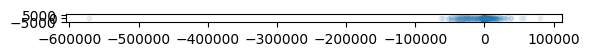

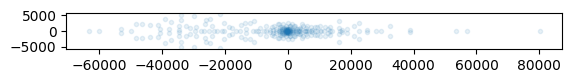

(-0.4488914906978607, 0.9882122874259949)

In [175]:
# 看head+mlp[0]的ov circuit所作的变换, 2-gram ov 15-3, NE (esp. places) qk 4-4, x->num qk 6-15
# prev ov: 13-9, next num ov: 14-13, next word ov: 13-4, prepend space ov: 18-3/17-10, isa ov: 14-7, antonym ov: 16-14, copy ov 13-2
# NE qk 6-9 who also has copy-like ov
# subword num->whole word num qk and suffix token copy ov 3-6
# 4-3: lower-layer 8-1 12-10 like head
# 10-4: x->adv ov, e.g. including, resulting, subsequently, therefore
# 8-13: place NE qk
# **8-7: coref resolution qk, also very interesting ov
# 6-2: same qk
# 10-7: copy and next fused ov
# 4-1: num, name and place qk
# 24-11: copy ov, esp. num, prepend space
# 22-14: suffix token copy ov
# 21-8: copy ov, 1st letter to upper
# 22-5: copy ov, prepend space, 1st letter to lower, to original form
# 23-2: prefix token copy ov, prepend space, 1st letter to lower
# 3-9: subword->whole word qk for word completion
# 8-2: same qk; 7-9 year and place qk; 7-2 type->instance qk, dual to isa ov 14-7, can be used for coref resolution
# 7-14: x->NE qk; 6-1: x->adv/adj qk; 6-0: x->noun qk; special token and symbol qk 1-7
# next num qk 3-12 (work with prev ov), + 2-11 = same qk!; x->suffix qk 7-6 + 2-11
# prev word+num qk 3-3 (work with next ov), general qk 3-11
layer, head = 7, 9
wq, wk, wv, wo = get_head_weights(model, layer, head, transpose=True)
# layer0, head0 = 8, 7; wv0, wo0 = get_head_weights(model, layer0, head0, transpose=True)[2:]
# if layer0 is not None: ek = blocks[layer].ln_1(blocks[layer0].ln_1(_e) @ wv0 @ wo0)

e = blocks[layer].ln_1(es[1])

qk = True
if qk:
    # e @ wq @ wk @ e
    A, B = e @ wq, e @ wk
    m = A @ B.T
else:
    # @ wv @ wo @ wu.T
    A, B = wu @ wo.T, e @ wv  #  wu, ln_f(e @ wv @ wo)  # slow for eig
    m = wu @ ln_f(B @ wo).T  # a little better than A @ B.T
plot_eigv((B.T @ A).eig()[0])

In [160]:
mean, std = m.mean(), m.std()

In [214]:
b = m > mean + std * 4.5
b.sum()
b.max(1).values.sum(), b.max(0).values.sum()

tensor(24800)

(tensor(7213), tensor(4442))

In [215]:
sample_all_top_entries(tokenizer, m, b, transpose=False)

  -- juven -- [('âĢĲ', 4), ('-', 3), ('âĢĳ', 3)]
  -- ĠBra -- [('utonium', 3), ('plugins', 0)]
  -- alse -- [('âĢĲ', 4), ('-', 2), ('âĢĵ', 0)]
  -- ĠLavrov -- [('âĢĲ', 0)]
  -- ĠWake -- [('umbledore', 3)]
  -- === -- [('Č', 0)]
  -- Ġgorge -- [('Depths', 0)]
  -- ĠLiverpool -- [('Liverpool', 1)]
  -- ĠMinion -- [('Computer', 1), ('Staff', 0)]
  -- count -- [('-+-+', 2), ('âĢĲ', 0)]
  -- ĠSlaughter -- [('.-', 0)]
  -- Ġbung -- [('ĠGamergate', 10), ('bledon', 10), ('ĠAssange', 8), ('ĠAwakens', 7), ('Spawn', 7), ('ĠJoker', 6), ('ĠLEGO', 6), ('bender', 6), ('ĠBridgewater', 6), ('window', 5), ('Wheel', 5), ('ĠWinnipeg', 4), ('Ġwaterfront', 4), ('Ġbackdoor', 4), ('ĠBaseball', 3), ('ĠPirate', 3), ('ĠMLB', 3), ('ĠBarnes', 3), ('ĠBengals', 3), ('Ġdumped', 3), ('ĠBattlefield', 3), ('ĠDock', 3), ('ĠBarnett', 3), ('assembly', 3), ('Ġspherical', 3), ('Gaming', 3), ('ĠWarehouse', 3), ('ĠBorderlands', 3), ('Ġclubhouse', 3), ('ĠSports', 2), ('ĠPackers', 2), ('akespeare', 2), ('basketball', 2), ('wheel

In [177]:
# for country, (capital,) in country2capital().items():
print(lookup_top_entries(tokenizer, m, 'high'))

{'Ġlowering': 35, 'Ġlows': 34, 'Ġlowly': 33, 'Ġsocioeconomic': 32, 'Ġunderside': 32, 'Ġlowest': 32, 'Ġlow': 31, 'ĠLow': 31, 'Ġrelegation': 29, 'Ġunderwater': 29, 'Ġborderline': 28, 'ĠElementary': 28, 'Ġlowered': 28, 'Ġmoderation': 27, 'Ġunderdog': 27, 'Ġankle': 27, 'Ġmiser': 27, 'Low': 27, 'ĠAHL': 26, 'Ġlowers': 26}


In [ ]:
# m = _m  # q->k, output->input
m = _m.T  # k->q, input->output
values, indices = m.topk(25, largest=True)

indices_fn = tokenizer.convert_ids_to_tokens
for i in values.abs().mean(1).topk(500).indices.tolist():
    print(indices_fn(i), show_topk(values[i][:6], indices[i][:6], indices_fn=indices_fn))

In [368]:
outputs, inputs, values = topk_md(m, 10000)
pairs = list(zip(tokenizer.convert_ids_to_tokens(outputs), tokenizer.convert_ids_to_tokens(inputs)))
pairs = [(o.replace('Ġ', '').lower(), i.replace('Ġ', '').lower()) for o, i in pairs]; len(pairs)
# https://stackoverflow.com/questions/480214/how-do-i-remove-duplicates-from-a-list-while-preserving-order
pairs = list(dict.fromkeys(pairs)); len(pairs)
if remove_similar:
    n0 = len(pairs)
    pairs = [(o, i) for o, i in pairs if o != i]; len(pairs)
    pairs = [(o, i) for o, i in pairs if not o.startswith(i)]; len(pairs)
    pairs = [(o, i) for o, i in pairs if not i.startswith(o)]; len(pairs)
    n1 = len(pairs)
    
# sorted(pairs, key=lambda x: x[0])
# d = defaultdict(list)
# for o, i in pairs: d[o].append(i)
# for k, v in sorted(d.items(), key=lambda x: len(x[1]), reverse=True): print(k); print(v)

10000

8490

8490

8490

8490

In [826]:
words = ['car', 'bus', 'tractor', 'airplane', 'ship', 'bicycle', 'truck', 'train', 'motorbike', 'helicopter', 'carriage', 
                'subway', 'taxi', 'van', 'boat']
# words = types_of_things()['']
words = ['van']
all_ids = [tokenizer.encode(' ' + word) for word in words]
_v, _v0 = zip(*[[m.T[ids[0]] for m in [_m, _m0]] for ids in all_ids if len(ids) == 1])
[(word, tokenizer.tokenize(' ' + word)) for word, ids in zip(words, all_ids) if len(ids) != 1]
for v in [_v, _v0]:
    d = show_topk(*torch.stack(v).mean(0).topk(20), indices_fn=indices_fn); (d.keys(), d.values())

[]

(dict_keys(['Ġrevital', 'Ġrebuild', 'Ġreinstated', 'Ġreorgan', 'Ġredesign', 'Ġrestored', 'Ġsupport', 'ĠLeadership', 'Ġmourning', 'Ġrebuilding', 'Ġrestoring', 'Ġrestructuring', 'Ġrevived', 'Ġreforms', 'Ġresusc', 'Ġrevive', 'Ġrebuilt', 'Ġrich', 'Ġrestoration', 'Ġresurrect']),
 dict_values([16.688, 14.742, 14.5, 14.442, 14.387, 14.135, 13.959, 13.836, 13.745, 13.539, 13.537, 13.343, 13.006, 12.91, 12.886, 12.857, 12.748, 12.718, 12.704, 12.53]))

(dict_keys(['Ġanalysts', 'Ġgenerals', 'Sold', 'Ġanalyst', 'ĠIntelligence', 'Ġintelligence', 'Ġtesting', 'Ġdoctors', 'Ġphysicians', 'Ġtactical', 'Ġtesters', 'Analy', 'Ġtests', 'Ġsoldiers', 'Ġracist', 'Ġclinicians', 'Ġanaly', 'Ġdiagn', 'Ġspec', 'Ġarmed']),
 dict_values([1.737, 1.704, 1.59, 1.492, 1.486, 1.467, 1.457, 1.438, 1.425, 1.407, 1.405, 1.403, 1.403, 1.396, 1.395, 1.391, 1.39, 1.384, 1.384, 1.372]))

In [829]:
for typ, things in types_of_things().items():
    print(f"Types of {typ}: {', '.join(sample(things, 6))}")

Types of animal: lion, tiger, goose, horse, squirrel, goat
Types of drink: beer, juice, soda, whiskey, cocktail, tea
Types of food: pizza, cake, hamburger, burger, bread, steak
Types of weapon: handgun, revolver, pistol, cannon, shotgun, grenade
Types of color: yellow, green, black, pink, red, gray


## Attribution

In [ ]:
nrows = 1; k_shot = 0
# text = 'The Space Needle is in the city of Seattle.'
# text = 'Megan Rapinoe plays the sport of soccer.'
text = 'When Mary and John went to the store, John gave a drink to Mary.'
input_ids = data_tuples[0][1]
attn_mask = torch.ones(input_ids.size(1), input_ids.size(1)) * (-1e9)
attn_mask[:, [1, 3]] = 0
attn_mask = attn_mask.tril()
data_tuples = [predict(model, tokenizer, text, None, k_shot=k_shot, bos_token='Ġto', eos_token=None)]

In [ ]:
if model_name == 'EleutherAI/gpt-neox-20b': model, _ = models[model_name] # switch back from cpu to gpu model
data_tuples = [predict(model, tokenizer, text, examples, k_shot=k_shot, bos_token=bos_token, eos_token=eos_token)[0]
    for text, examples in zip(texts, all_examples)]

In [ ]:
topk_md(get_head_matching_scores(data_tuples, 'bos->ans0]', k_shot=k_shot), 10)

In [ ]:
top_heads = topk_md(attn_mll, 1, transpose=True)#[2:4]
for l, h, v in top_heads:
    print(l, h, v)
    for text, input_ids, labels, ranges, *args, o, attn_attr in data_tuples:
        print(text[:10])
        aw = o.attentions[l][0, h]
        bos_indices = args[1]; ystart = bos_indices[k_shot]; ystop = aw.size(0)
        tokens = [t.replace('Ġ', '').replace('Ċ', '-'*12) for t in tokenizer.convert_ids_to_tokens(input_ids[0])]
        plot_attn(aw, tokens, ystart=None, ystop=None, topk=int(len(ranges) * 1.5),
            figsize=(20, 20), fontsize=9, transpose=True, use_imshow=False)
        plt.show()

In [ ]:
si = -1
attribute_k = False
root = node = Node('[-1] root'); node.data = AttrData(step=si, label_type='argmax_labels')
nodes = {}; nodes[si] = node; print_tree(root)

In [ ]:
# 查看当前父节点的信息
# si = 0
parent = nodes[si]#.parent.children[0]
print(parent.name)
attr = parent.data.attr
topk_md(attr.head, 10) # list(zip(*topk_md(attr.head, 10)))
topk_md(attr.mlp, 5) # list(zip(*topk_md(attr.mlp, 5)))

In [ ]:
# 选择下一步要归因的head/mlp，创建节点数据
topi = [0, 1, 2]
layer, head = topk_md(attr.head, 10, transpose=True)[:2][topi][:2] if type(topi) == int \
    else np.array(topk_md(attr.head, 10)[:2])[:, topi]
# layer, head = list(zip(*topi_md(attr.mlp, 10)))[topi][0], None
label_type = [None, 'labels', 'argmax_labels', 'argmax_attn_labels', 'attn_labels'][-1]
attribute_k = False
if si == -1: assert label_type is not None # in ['labels', 'argmax_labels', 'argmax_attn_labels', 'attn_labels']
else: label_type = None
data = AttrData(step=si + 1, topi=topi, layer=layer, head=head, label_type=label_type, 
    attribute_k=label_type in ['argmax_attn_labels', 'attn_labels'] and attribute_k)
print(data2str(data))

In [ ]:
# 创建节点添加到树，并作为当前父节点
si += 1
node = Node(data2str(data), parent); node.data = data; nodes[si] = node
print([dt[0] for dt in data_tuples], k_shot)
nodes[si].name = '*' + nodes[si].name
print_tree(root)
nodes[si].name = nodes[si].name[1:]  # strip prepending '*'

In [ ]:
attrs, attrs2 = [], []#; node = nodes[si]
for text, input_ids, labels, ranges, *_, o in data_tuples:
    fns = path2fns(node, root, partial(node2fn, model=model, outputs=o, labels=labels))
    (output_layer, _labels) = (node.data.layer, None) if len(fns) > 0 else (L, labels)
    if _labels is not None and root.data.label_type == 'argmax_labels':
        _labels = get_argmax_labels(model, o.hidden_states[-2], _labels)
    to_layer = max(output_layer) if isinstance(output_layer, Iterable) else output_layer
    fwd_fn = partial(sum_forward, outputs=o, labels=_labels, output_layer=output_layer)
    keys = ['embed_mask', 'mlp_mask', 'attn_weights']
    x = OrderedDict((key, get_x(key, o, to_layer=to_layer)) for key in keys)
    attr, ys, logits = attribute(fwd_fn, model, x, fns, num_points=4 if attribute_k else 7) 
    # fwd_fn = partial(sum_forward, outputs=o, labels=_labels, reduce_fn=torch.cat, scaled=False)
    attr2 = attr #attribute2(fwd_fn, model, x, fns)

    attrs.append(attr); attrs2.append(attr2)
    o.attn_attr[node.name] = attr.attn # associate non-averageable attn attr to current node. tricky
        
print(f'attribution step {si} results')
attr = reduce_objects(attrs, ['head', 'neuron', 'mlp']); attr2 = reduce_objects(attrs2, ['head', 'mlp'])
plot_attr(attr, attr2)
pd.concat([to_df(*topk_md(a[: to_layer], min(to_layer, 10)))
    for a in [attr.head, attr2.head, attr.mlp, attr2.mlp]], axis=1)
node.data.attr = attr

In [ ]:
for ap, topk in zip(attn_patterns_by_step[1], [1, 1]):
    # if ap != 'ans]->ans0]': continue
    print(ap)
    for head in topk_md(scores[ap], topk, transpose=True):
        plot_attns(data_tuples, tokenizer, *head, attn_pattern=ap)

In [ ]:
for l, h, v in topk_md(node.data.attr.head, 3, transpose=True):
    print(l, h, v)#, get_head_rank(attr2.head, l, h))#, eigv_positivity[l, h], pos_score[l, h])
    for text, input_ids, labels, ranges, *args, o in data_tuples[:4]:
        attn_attr = o.attn_attr
        fns = path2fns(node, partial(node2fn, model=model, outputs=o, labels=labels))
        fwd_fn = partial(sum_forward, outputs=o, output_layer=l)
        _labels = labels if len(fns) == 0 else None
        # _labels = get_argmax_labels(model, o.hidden_states[-2], _labels)
        fn = partial(head_forward, layer=l, head=h, attn_weights=o.attentions[l], labels=_labels) \
            if h >= 0 else partial(mlp_forward, layer=l, labels=_labels)
        keys = ['embed_mask', 'mlp_mask', 'attn_weights']
        x = OrderedDict((key, get_x(key, o, to_layer=l)) for key in keys)
        _, ys, logits = attribute(fwd_fn, model, x, [fn] + fns, num_points=3, forward_only=True); print(ys)
        if iterable(logits): logits = sum(logits)
        if logits.size(-1) == model.lm_head.out_features:  # lm_logits
            _ = show_predictions(tokenizer, *args, logits=logits[-1:], labels=_labels, topk=4, sep='\t')
        # elif logits.size(-1) == input_ids.size(1): # attn_logits, bij
        #     plot_attn(logits[-1].softmax(dim=-1), tokens, figsize=(5, 5))  # bnij->ij
        #     plot(logits[-1, -3, :13])

        if h == -1: continue
        attn, aa = o.attentions[l][0, h], attn_attr[node.name][l, h]
        bos_indices = args[1]; ystart = (node.data.step <= 0)*bos_indices[k_shot]; ystop = aa.size(0)
        # fig, axs = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(20, 10*(ystop-ystart)/aa.size(0)))
        fig, axs = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(40*(ystop-ystart)/aa.size(0), 20))
        tokens = [t.replace('Ġ', '').replace('Ċ', '-'*12) for t in tokenizer.convert_ids_to_tokens(input_ids[0])]
        y_pos, x_pos, _ = topk_md(aa, k=nrows-k_shot)
        if True: #with Timer():
            for ax, a in zip(axs, [attn, aa]):
                plot_attn(a, tokens, ax=ax, ystart=ystart, ystop=ystop, y_pos=y_pos, x_pos=x_pos,
                fontsize=9, transpose=True, use_imshow=False)
            plt.show()

In [ ]:
group0 = [(1, 7), (6, 2), (8, 7)]; group1 = [(3, 6), (3, 11), (4, 8), (6, 10)]
neuron = attr.neuron
for (l0, h0), (l1, h1) in product(group0, group1):
    print(f'{l0}-{h0}, {l1}-{h1}', nn.CosineSimilarity(0)(neuron[l0, h0].mean(0), neuron[l1, h1].mean(0)))
print()
for (l0, h0), (l1, h1) in combinations(group0, 2):
    print(f'{l0}-{h0}, {l1}-{h1}', nn.CosineSimilarity(0)(neuron[l0, h0].mean(0), neuron[l1, h1].mean(0)))
print()
for (l0, h0), (l1, h1) in combinations(group1, 2):
    print(f'{l0}-{h0}, {l1}-{h1}', nn.CosineSimilarity(0)(neuron[l0, h0].mean(0), neuron[l1, h1].mean(0)))

In [ ]:
attr = nodes[i].data.attr
for l, h, v in zip(*topk_md(attr.head, 1)):
    # if l != 14: continue
    print(l, h, v, get_head_rank(attr2.head, l, h))
    for text, examples, inputs, tokens, bos_indices, eos_indices, answers, labels, o, attn_attr in data_tuples[1:2]:
        x = OrderedDict((key, get_x(key, o, to_layer=l)) for key in keys)
        fwd_fn = partial(sum_forward, outputs=o)
        fn = partial(head_forward, layer=l, head=h, attn_weights=o.attentions[l],
                            labels=labels if len(fns) == 0 else None)
        post_fwd_fn = compose_forward_fns([fn] + fns, scaled=True)
        _, ys, logits = attribute(fwd_fn, model, x, post_fwd_fn, num_points=3, batch_size=3); print(ys)
        if logits.size(-1) == model.lm_head.out_features:
            show_predictions(text, examples, tokenizer, logits[-1:], bos_indices, eos_indices, answers, labels, 
                topk=4, show_range=range(k_shot, len(examples)), sep='\t')

        fig, axs = plt.subplots(1, 2, sharex=False, sharey=False, figsize=(20, 10))
        aa = attn_attr[nodes[i].name][l, h]
        # attn_labels = aa / (aa.sum(-1, keepdim=True) + 1e-9)  # ij->i1
        for ax, a in zip(axs, [o.attentions[l][0, h], aa, ]):
            plot_attn(a, tokens, ax=ax)
        plt.show()

In [ ]:
# 对某层的attn_weights单独梯度归因
attrs = []
for attribute_layer in range(27):
    forward_fn = partial(forward, inputs=inputs, labels=labels, loss_reduction='per_example_mean', attribute_layer=attribute_layer)
    x = {'head_mask': torch.ones(1, H, o.hidden_states[0].size(1))}
    def get_y(outputs): return -outputs.loss
    attr, ys = attribute(forward_fn, x, get_y, num_points=8)
    ys
    attrs.append(attr)
    
head_attr2 = rearrange([attr['head_mask'] for attr in attrs], 'l n i -> l n i')
head_attr2 = torch.einsum('lni->ln', head_attr2)
list(zip(*topk_md(head_attr2, 10)))

# 对某层的attn_weights单独梯度归因
for attribute_layer, attribute_head, __ in list(zip(*topk_md(head_attr, 10)))[:3]: # heads 27-17, 17-4, 22-13
    forward_fn = partial(forward, inputs=inputs, labels=labels, loss_reduction='per_example_mean', attribute_layer=attribute_layer)
    x = {'attn_weights': o.attentions[attribute_layer]}
    def get_y(outputs): return -outputs.loss
    attr, ys = attribute(forward_fn, x, get_y)
    # ys
    print(attribute_layer, attribute_head)
    plot_attn(attr['attn_weights'][attribute_head], tokens, figsize=(5, 5))
    plt.show()

以上用归因找到对最终预测结果起重要作用的上层heads（induction heads），  
以下用归因找到对上层induction heads的attn_weights起重要作用的下层heads（Q-compostion or K-composition with induction heads）

In [ ]:
# 找第2重要的induction head（17-4）的K-composition heads
layer, head, _ = list(zip(*topk_md(head_attr, 10)))[1]
layer, head
aw_label = binarize(attn_attr[layer, head])
wq, wk = get_head_weights(layer, head)[:2]

In [ ]:
# 对head_output归因
query = torch.einsum('bie,de->bid', o.hidden_states[layer], wq)
head_outputs = rearrange(list(o.head_outputs), 'l 1 n i e -> 1 l n i e')[:, :layer]
key = torch.einsum('blnje,de->blnjd', head_outputs, wk)
attn_logits = torch.einsum('bid,blnjd->lnij', query, key) # b==1
# i j l n -> n_label l n -> ln
attn_head_attr = rearrange(attn_logits, 'l n i j -> i j l n')[aw_label == 1].mean(0)

In [ ]:
_ = sns.heatmap(attn_head_attr)
list(zip(*topk_md(attn_head_attr, 10)))

In [ ]:
# 对attn_weights归因
# h2: a higher-layer (induction) head (layer, head)
# h1: lower-layer heads forming K-composition with h2
# i: h2 query position, j: h2 key position, k: h1 query position
head_inputs_ = rearrange(list(o.head_inputs), 'l 1 n j e -> l n j e')[:layer]
attentions_ = attentions[:layer]
if True: # faster version
    key = head_inputs_ @ wk.T  # lnje,de->lnjd
    lnkj_attn_logits = torch.einsum('bkd,lnjd->lnkj', query, key) # b==1
    lnkij_attn_logits = torch.einsum('lnij,lnkj->lnkij', attentions_, j_attn_logits)
else: # slower version, but easier to understand (similar to unseal)
    lnije = torch.einsum('lnij,lnje->lnije', attentions_[:layer], head_inputs_)
    key = lnije @ wk.T  # lnije,de->lnijd    
    lnkij_attn_logits = torch.einsum('bkd,lnijd->lnkij', query, key)  # b==1
# kij means k attends i in higher layer, i attends j in lower layer
attn_attn_attr = torch.einsum('lnkij,ki->lnij', lnkij_attn_logits, aw_label)

In [ ]:
for l, h, v in zip(*topk_md(attn_head_attr, 10)):
    print(l, h, v)
    fig, axs = plt.subplots(1, 3, sharex=False, sharey=False, figsize=(15, 5))
    for ax, a in zip(axs, [attentions[l, h], attn_attn_attr[l, h], binarize(attn_attn_attr[l, h])]):
        plot_attn(a, tokens, ax=ax)
    plt.show()

## Tune intermediary heads

In [ ]:
d = defaultdict(int)
pairs = []
for l0, h0, l2, h2 in zip(*np.unravel_index(affinities.view(-1).topk(500).indices, affinities.size())):
    if d[(l0, h0)] < 10:
        d[(l0, h0)] += 1
        pairs.append(((l0, h0), (l2, h2)))
        if len(pairs) == 100: break
Counter([(l0, h0) for (l0, h0), (l2, h2) in pairs]).most_common()
random.shuffle(pairs)
train_set, val_set = pairs[:-20], pairs[-20:]

In [ ]:
def w_forward(head_pairs, wv1, wo1, alpha=0.1, compute_eigv=False):
    wvs0, wos0, wqs2, wks2 = zip(*[get_head_weights(model, l0, h0, transpose=True)[2:] +
                                get_head_weights(model, l2, h2, transpose=True)[:2] 
                                for (l0, h0), (l2, h2) in head_pairs])
    wvs0, wos0 = rearrange(list(wvs0), 'b e d -> b e d'), rearrange(list(wos0), 'b d e -> b d e')
    wqs2, wks2 = rearrange(list(wqs2), 'b e d -> b e d'), rearrange(list(wks2), 'b e d -> b e d')
    wvs0, wos0, wqs2, wks2 = wvs0.to(device), wos0.to(device), wqs2.to(device), wks2.to(device)
    wvo1 = wv1 @ wo1
    q, kT = wvs0 @ wos0 @ wvo1 @ wqs2, wks2.transpose(-2, -1)
    comp_norm = (q @ kT).norm(dim=(-2, -1)).mean()
    # loss = -comp_norm / wvo1.norm()
    loss = -(comp_norm - alpha * wvo1.norm())
    eigvs = [plot_eigv(m.eig()[0], plot=False) for m in kT @ q] if compute_eigv else None
    return loss, comp_norm, eigvs
    
def eval(dataset, wv1, wo1, bsz=8, compute_eigv=False, e=None, wu=None):
    losses, eigvs, comp_norms = [], [], []
    for i in range(len(dataset) // bsz):
        loss, comp_norm, _eigvs = w_forward(dataset[i * bsz: (i + 1) * bsz], wv1, wo1, compute_eigv=compute_eigv)
        losses.append(loss.item())
        comp_norms.append(comp_norm.item())
        if compute_eigv: eigvs += _eigvs
    if compute_eigv:
        print(torch.Tensor(eigvs))
        # e = model.transformer.h[l1].ln_1(_e)
        A, B = wu @ wo1.T.to('cpu'), e @ wv1.to('cpu')
        print('wvo1 eigv_pos =', plot_eigv((B.T @ A).eig()[0], plot=False))
    return round(sum(losses) / len(losses), 4), round(sum(comp_norms) / len(comp_norms), 4), round((wv1 @ wo1).norm().item(), 4)

In [ ]:
device = 'cuda'
wv1, wo1 = get_head_weights(model, l1, h1, transpose=True)[2:]
wv1, wo1 = wv1.detach().clone(), wo1.detach().clone()
wv1, wo1 = wv1.to(device), wo1.to(device)
_ = wv1.requires_grad_(True); _ = wo1.requires_grad_(True)
optimizer = optim.AdamW([wv1, wo1], lr=1e-4)
bsz, eval_bsz = 8, 4
# test(model, data_tuples)
# test(model, data_tuples, replaced_head=(l1, h1), wv=wv1.to('cpu'), wo=wo1.to('cpu'))
# test(model, data_tuples, replaced_head=(l1, h1), wv=wv1.to('cpu'), wo=2*wo1.to('cpu'))
with torch.no_grad(): print('Epoch', -1, 'train', eval(train_set, wv1, wo1), 
                        'val', eval(val_set, wv1, wo1, bsz=eval_bsz, compute_eigv=True, e=e, wu=wu))
for epoch in range(2):
    random.shuffle(train_set)
    for i in tqdm(range(len(train_set) // bsz)):
        optimizer.zero_grad()
        loss = w_forward(train_set[i * bsz: (i + 1) * bsz], wv1, wo1)[0]
        loss.backward()
        optimizer.step()
    with torch.no_grad(): print('Epoch', epoch, 'train', eval(train_set, wv1, wo1), 
                            'val', eval(val_set, wv1, wo1, bsz=eval_bsz, compute_eigv=True, e=e, wu=wu),)
                            # test(model, data_tuples, replaced_head=(l1, h1), wv=wv1.to('cpu'), wo=wo1.to('cpu')))

In [ ]:
all_attrs, all_yss = {}, {}

In [ ]:
def qk_forward(model, outputs, layer, head, aw_label, attr_x, **mask_kwarges):
    ln = blocks[layer].ln_1
    kwargs = {x: ln(outputs.hidden_states[layer]) for x in ['hq', 'hk', 'hv']}
    kwargs[attr_x] = scaled_ln(ln, sum_forward(model, outputs, **mask_kwarges).hidden_states[0], scale=0.01) # attr_x in ['hq', 'hk']
    aw = attn_forward(blocks[layer], **kwargs)[1][:, head]
    aw_label_sum = torch.einsum('ij->', aw_label)
    # print('aw_label_sum =', aw_label_sum)
    mean_prob = torch.einsum('bij,ij->b', aw, aw_label) / aw_label_sum
    mean_logprob = torch.einsum('bij,ij->b', (aw + 1e-8).log(), aw_label) / aw_label_sum
    print('mean_prob =', mean_prob)
    print('mean_logprob =', mean_logprob)
    return mean_prob, mean_logprob

In [ ]:
# ig attribution
pred_attn = False
keys = ['aw'] #  'attn_out', 'head_out', 'attn_output', 'ffn_output'
keys2 = [] #['head_output', 'attn_output']
layer_range = (0, layer1) if pred_attn else (0, layer_out)
attrs, grads = defaultdict(list), defaultdict(list)
num_points, batch_size = 5, 5
    
for i in tqdm(range(*layer_range)):
    am = get_attn_module(blocks[i])
    scaled_emb, step, grad = {}, {}, {}
    embs = [getattr(o, keys[0])[i]]
    if len(embs) == 1 and keys[0] != 'aw': all_embs[task_name][keys[0]] = embs[0][0]
        
    for key, emb in zip(keys, embs):
        scaled_emb[key], step[key] = scaled_input(emb, num_points)
        _ = scaled_emb[key].requires_grad_(True)
        grad[key] = None
    if i == layer0: ys = []
    for j in range(0, num_points, batch_size):
        sliced_scaled_emb = [scaled_emb[key][j: j + batch_size] for key in keys]
#         for key in keys2: setattr(am if key in ['head_output'] else blocks[i], key, None)
        outputs = forward(am, keys, values=sliced_scaled_emb, exit_module=blocks[layer1+1] if pred_attn else None)
        y = globalize(outputs.attentions[layer2])[:, head2, src, tgt] if pred_attn else outputs.logits.softmax(-1)[:, src, pred_label]
#         h1 = ln1(outputs.hidden_states[12])
#         y = tgt_attn_loss(h1, _attn1, key0, residual=None, temperature=20)
        if i == layer0: ys.append(y)
#         if keys2:
#             sliced_scaled_emb2 = [getdelattr(am if key in ['head_output'] else blocks[i], key) for key in keys2]
#             sliced_scaled_emb += sliced_scaled_emb2
#             if j == num_points - batch_size: step.update({key: emb[-1:]/num_points for key, emb in zip(keys2, sliced_scaled_emb2)})
        sliced_grads = torch.autograd.grad(y.flatten().unbind(), sliced_scaled_emb)
        for gi, key in enumerate(keys + keys2):
            sliced_grad = sliced_grads[gi].sum(dim=0, keepdim=True)
            grad[key] = sliced_grad if key not in grad or grad[key] is None else grad[key] + sliced_grad
    for key in keys + keys2:
        attr = grad[key] * step[key]
        attrs[key].append(attr.data)
        grads[key].append(grad[key].data)

if len(keys) == 1:
    key = keys[0]
    all_attrs[task_name][key + str(int(pred_attn))] = torch.cat([globalize(a) for a in attrs[key]]) \
        if key == 'aw' else attrs[key][0][0]
#     for key in keys2: attrs[key] = torch.cat(attrs[key])

In [ ]:
attrs, yss = all_attrs[key], all_yss[key]

In [ ]:
dlosses = [(ys[0] - ys[-1]).item() for ys in yss]
np.array(dlosses)
_ = plt.bar(range(len(dlosses)), dlosses, 0.3)

In [ ]:
# nattrs = [attr / abs(dloss) for attr, dloss in zip(attrs, dlosses)]
nattrs = [attr / attr.abs().mean() for attr in attrs]

In [ ]:
mean_nattrs = torch.cat([nattr.mean(dim=-1) for nattr in nattrs])

In [ ]:
_ = sns.heatmap(mean_nattrs, cbar=True)

In [ ]:
l, h = 6, 6
# attn = o.attentions[l][0, h]
attn = attrs[l][0, h]
plot_attn(attn, tokens)

QK circuit: $W_E^T W_Q^T W_K W_E$  
OV circuit: $W_U W_O W_V W_E$

In [ ]:
def plot_eigenvalues(evs, ncols=4):
    fig, axs = plt.subplots(H // ncols, ncols, sharex=True, sharey=True, figsize=(20, 5))
    for i, (e, v) in enumerate(evs):
        e = e.detach().numpy()
        _ = axs[i // ncols][i % ncols].plot(e[:,0], e[:,1], '.')

In [ ]:
WQK, WOV = [], []
for l in tqdm(range(L)):
    WQK.append([combine_weights(get_head_weights(l, h), qk=True) for h in range(H)])
    WOV.append([combine_weights(get_head_weights(l, h), qk=False) for h in range(H)])

In [ ]:
WQK = [[combine_weights(get_head_weights(l, h), qk=True) for h in range(H)] for l in tqdm(range(L))]
WOV = [[combine_weights(get_head_weights(l, h), qk=False) for h in range(H)] for l in tqdm(range(L))]

In [ ]:
# rwqk2, rwov1 = torch.rand(hidden_size, hidden_size) * 10, torch.rand(hidden_size, hidden_size) * 100

# rwq, rwk = torch.rand(hidden_size // H, hidden_size)*10, torch.rand(hidden_size // H, hidden_size)
# rwo, rwv = torch.rand(hidden_size, hidden_size // H), torch.rand(hidden_size // H, hidden_size)*100
# rwqk2, rwov1 = rwq.t().mm(rwk), rwo.mm(rwv)

# rwqk2.mm(rwov1).norm() / (rwqk2.norm() * rwov1.norm())

K-composition: $\text{Id} \otimes A^{h_{-1}} \otimes (W_E^T W_{QK}^h W_{OV}^{h_{-1}} W_E)$, measured by Frobenius norm ratio: $||W_{QK}^{h_2}W_{OV}^{h_1}||_F \mathbin{/} (||W_{QK}^{h_2}||_F ||W_{OV}^{h_1}||_F)$

In [ ]:
dl = 3
kcomp3 = np.array([[[(WQK[l][h2].mm(WOV[l-dl][h1]).norm() / (WQK[l][h2].norm() * WOV[l-dl][h1].norm())).item() 
          for h1 in range(H)] for h2 in range(H)] for l in tqdm(range(dl, L))])

In [ ]:
def scatter_plot(a): a = a.detach().numpy(); plt.plot(a[:,0], a[:,1], '.')

In [ ]:
chains = [
    [(4, 14), (3, 3)],  # 0.24024388
    [(5, 4), (2, 2)],  # 0.21996385
    [(5, 4), (3, 7)],  # 0.31488344
    [(6, 6), (3, 3)],  # 0.27304175
    [(6, 6), (5, 3)],  # 0.12567882
]

In [ ]:
(l2, h2), (l1, h1) = chains[4]

In [ ]:
e = WQK[l2][h2].mm(WOV[l1][h1]).eig()[0]

In [ ]:
e[:10] = 0

In [ ]:
scatter_plot(e)

In [ ]:
e = WOV[l2][h2].eig()[0]

In [ ]:
scatter_plot(e)

In [ ]:
a = kcomp3[2]; ind = np.unravel_index(a.argmax(), a.shape); ind, a[ind]

In [ ]:
kcomp = np.array(kcomp)
sns.heatmap(kcomp, cbar=True)

In [ ]:
wov_evs = [torch.eig(combine_weights(get_head_weights(3, h), qk=False, with_embedding=True, BA=True)) for h in tqdm(range(H))]

In [ ]:
plot_eigenvalues(wov_evs)

In [ ]:
w_eu = w_e.matmul(w_u)

In [ ]:
def mlp(layer): return lambda x: blocks[layer].mlp(blocks[layer].ln_2(x))
def mlp0(layer): return lambda x: blocks[layer].mlp(x)

In [ ]:
def attn(layer): return lambda x: blocks[layer].attn(blocks[layer].ln_1(x))

In [ ]:
w_e2 = w_e * 50
w_eu2 = (w_e2 + mlp0(L-1)(w_e2)).matmul(w_u)

In [ ]:
# grad attribution
pred_attn = False
keys = ['aw'] #  'attn_out', 'head_out', 'attn_output', 'ffn_output'
keys2 = [] #['head_output', 'attn_output']
layer_range = (0, layer1) if pred_attn else (0, layer_out)
attrs, grads = defaultdict(list), defaultdict(list)
num_points, batch_size = 5, 5
    
for i in tqdm(range(*layer_range)):
    am = get_attn_module(blocks[i])
    scaled_emb, step, grad = {}, {}, {}
    embs = [getattr(o, keys[0])[i]]
    if len(embs) == 1 and keys[0] != 'aw': all_embs[task_name][keys[0]] = embs[0][0]
        
    for key, emb in zip(keys, embs):
        scaled_emb[key], step[key] = scaled_input(emb, num_points)
        _ = scaled_emb[key].requires_grad_(True)
        grad[key] = None
    if i == layer0: ys = []
    for j in range(0, num_points, batch_size):
        sliced_scaled_emb = [scaled_emb[key][j: j + batch_size] for key in keys]
#         for key in keys2: setattr(am if key in ['head_output'] else blocks[i], key, None)
        outputs = forward(am, keys, values=sliced_scaled_emb, exit_module=blocks[layer1+1] if pred_attn else None)
        y = globalize(outputs.attentions[layer2])[:, head2, src, tgt] if pred_attn else outputs.logits.softmax(-1)[:, src, pred_label]
#         h1 = ln1(outputs.hidden_states[12])
#         y = tgt_attn_loss(h1, _attn1, key0, residual=None, temperature=20)
        if i == layer0: ys.append(y);
#         if keys2:
#             sliced_scaled_emb2 = [getdelattr(am if key in ['head_output'] else blocks[i], key) for key in keys2]
#             sliced_scaled_emb += sliced_scaled_emb2
#             if j == num_points - batch_size: step.update({key: emb[-1:]/num_points for key, emb in zip(keys2, sliced_scaled_emb2)})
        sliced_grads = torch.autograd.grad(y.flatten().unbind(), sliced_scaled_emb)
        for gi, key in enumerate(keys + keys2):
            sliced_grad = sliced_grads[gi].sum(dim=0, keepdim=True)
            grad[key] = sliced_grad if key not in grad or grad[key] is None else grad[key] + sliced_grad
    for key in keys + keys2:
        attr = grad[key] * step[key]
        attrs[key].append(attr.data)
        grads[key].append(grad[key].data)

if len(keys) == 1:
    key = keys[0]
    all_attrs[task_name][key + str(int(pred_attn))] = torch.cat([globalize(a) for a in attrs[key]]) \
        if key == 'aw' else attrs[key][0][0]
#     for key in keys2: attrs[key] = torch.cat(attrs[key])

In [ ]:
plot_attn(globalize(attentions[8])[0, 2], figsize=(20, 20))

In [ ]:
for i, token in enumerate(tokens):
    if token in ['Ċ', '^']: print()
    else: print('%2d %s' %(i, token), end='  ')
tgt_positions

In [ ]:
a = all_attrs[task_name]['aw' + str(int(pred_attn))]
a = a / a.view(a.size(0), -1).norm(dim=1)[:, None, None, None] #.view(a.size(0), 1, 1, 1)
if not pred_attn:
    src_indices, tgt_indices = [src], [tgt]
    _a = a[:, :, src_indices, tgt_indices]
    values, indices = _a.view(_a.size(0), H, -1).topk(1, dim=-1)
    show_top_heads(values, indices, src_indices=src_indices, tgt_indices=tgt_indices)
    print()
# src_indices = numpy(ans_positions[:])
# src_indices = numpy(tgt_positions + 1)
# tgt_indices = tgt_positions
_a = a[:, :, src_indices, :]
values, indices = _a.view(_a.size(0), H, -1).topk(nrows // 2, dim=-1)
show_top_heads(values, indices, src_indices=src_indices)#, tgt_indices=tgt_indices)

In [ ]:
def show_top_heads(values, indices, src_indices=None, tgt_indices=None, topk=15):
    val, ind = values.sum(dim=-1).view(-1).topk(topk)
    val, ind = numpy(val), unravel_index(ind, values.size()[:-1])
    for (l, h), v in zip(ind, val):
        _l = l + layer_range[0]
        if _l <= 3: continue
        top_links = list(zip(unravel_index(indices[l, h], (seq_len, seq_len)), numpy(values[l, h], decimals=3)))
        if src_indices is not None: top_links = [([src_indices[_s], _t], _v) for [_s, _t], _v in top_links]
        if tgt_indices is not None: top_links = [([_s, tgt_indices[_t]], _v) for [_s, _t], _v in top_links]
        top_links = [([_s, _t], _v, numpy(globalize(attentions[_l]) * 100, decimals=1)[0, h, _s, _t]) for [_s, _t], _v in top_links]
        _top_links = [([_s, _t], _v, _a) if len(src_indices) > 1 else (_t, _v, _a) for [_s, _t], _v, _a in top_links]
        print('%d-%d\t%.3f' % (_l, h, v), _top_links, end='\t') 
        if len(top_links) == 1:
            probs = numpy(globalize(attentions[_l])[0, h, src])
            for i in cand_range:
                if i == tgt: print('*', end='')
                print(probs[i], end=' ')
        print()

In [ ]:
a = globalize(attentions[layer2])[:, head2]
# a = a.softmax(-1)
a = torch.cat([a[:, i - 1: i, i - ncols - 2: i + 1] for i in ans_positions], dim=1)
# a = a.softmax(-1)
loss = a.view(a.size(0), -1)[:, tgt_positions[1:]].mean(dim=1)
print(loss)
plot_tgt_attn(a[0])

In [ ]:
wvos = [torch.matmul(*get_head_weights(l, h)[2:]) for l, h in [(11, 8), (12, 18)]]
wqk = torch.matmul(*get_head_weights(13, 2)[:2])
ww = wvos[0].matmul(wvos[1]).matmul(wqk)

In [ ]:
ww.norm(dim=0).topk(40).indices

In [ ]:
show_topk(*aw.view(-1).topk(20, largest=False), indices_fn=indices_fn)

In [ ]:
wvos2 = [torch.matmul(*get_head_weights(l, h)[2:]) for l, h in [(9, 9), (10, 1), (12, 18)]]
ww2 = reduce(torch.matmul, wvos2 + [wqk])

In [ ]:
attn_output1, out = None, None
out_proj_w = self1.out_proj.weight.view(hidden_size, H, -1).permute(1, 2, 0).unsqueeze(0)
head_mask = torch.zeros(H, seq_len, seq_len)
head_mask[[18,]] = 1
# head_mask[:] = 1
attn1 = attentions[layer1]
_attn1, __attn1 = torch.zeros_like(attn1), torch.zeros_like(attn1)
for i in range(0, nrows):
    _attn1[:, :, arrow_positions[i], ans_positions[i]] = 1
    __attn1[:, :, arrow_positions[i], ans_positions[:i]] = 1 / i if i > 0 else 0
    
def ffn(layer, x): return blocks[layer].mlp(blocks[layer].ln_2(x))

def tgt_attn_loss(h1, attn1, key0, residual=None, attn_output_w=1, apply_softmax=True, temperature=10, 
                  positions=tgt_positions, plot=False, ax=None):
    def get_attn(attn_output):
        out = (residual if residual is not None else 0) + attn_output * attn_output_w
        if residual is not None: out = out + ffn(layer1, out)
        if residual is not None: out = ln2(out)
        query = out.matmul(wq2.t()).unsqueeze(2) # (bsz, nrows, d_head) -> (bsz, nrows, 1, d_head), ln2 is omissible
        key = key0.matmul(wk2.t()).view(bsz, nrows, ncols + 3, hidden_size // H)
        a = (query * key).sum(-1) # (bsz, nrows, ncols + 3)
        a[:, :, [-1]] = -1e9
        if apply_softmax: a = (a / temperature).softmax(-1)
        return a

    self1.w = attn1 * head_mask; attn_output1 = self1(h1)[0] - self1.out_proj.bias
    a = get_attn(attn_output1[:, arrow_positions])
    loss = a.view(a.size(0), -1)[:, positions]
    if plot:
#         a = a - a.min(dim=2, keepdim=True).values
        plot_tgt_attn(a[0], ax=ax)#; print(loss)
    return loss.mean()

residual = None or hidden_states[layer1][:, arrow_positions]

In [ ]:
def get_ln(layer): return blocks[layer].ln_1
# 10-ffn, 9-11 for find special, 9-11 for AbCD->B/b, 9-11 for ABCD->C
# 10-19+ffn+8!, 9-11 for after bracket 5-5/7, 9-11, 10-1+13+ffn+8+19 for in brackets
mask = torch.zeros(H, seq_len, 1); mask[11] = 1#; mask[:] = 0 # 11-8, 10-1, 9-11,   9-11/6?->8-17 for 2nd
# for i in range(0, nrows): mask[1, ans_positions[i], tgt_positions[i]+1] = 1
layer0 = 9
self0, ln0 = get_attn_module(blocks[layer0]), blocks[layer0].ln_1

h0 = hidden_states[9]*0 + head_outputs[8][:, [17]].sum(1)*1
self0.w = attentions[layer0] * mask; attn_output0 = self0((h0), attention_masks[layer0])[0] - self0.out_proj.bias
# h1 = hidden_states[9]*0 + head_outputs[11][:, [8]].sum(1)*1 #+ ffn_outputs[10]#+ head_outputs[11][:, [8,]].sum(1)*1
# h1 = ln1(h1)
h1 = attn_output0
key0 = get_ln(10)(hidden_states[10])#; key0.reqires_grad = True; key0.retain_grad()
fig, axes = plt.subplots(1, 3, sharey=False, figsize=(2.5 * (ncols + 3) / 9 * 3, 5 * nrows / 24))
# loss = tgt_attn_loss(h1, __attn1, key0, residual=None, plot=True, apply_softmax=True, temperature=1, ax=axes[0]); loss
# print('after', key0[:, :, 0])
[tgt_attn_loss(h1, attn, key0, residual=None,plot=True,temperature=1, positions=tgt_positions[(i>0)*2:],ax=ax).item() 
    for i, (attn, ax) in enumerate(zip([_attn1, attn1, __attn1], axes))]
# if losses[0] > 0.8 and losses[-1] > 0.8: print(layer, head, losses)

In [ ]:
def get_weight_norm(w):
    return w.abs().mean().item()

In [ ]:
wvo1 = get_combined_w(9, 11) * get_combined_w(12, 18)
for layer in [8, ]:
    for head in range(H):
        wvo = get_combined_w(layer, head)
        print('%d-%d %.4f %.4f' % (layer, head, get_weight_norm(wvo.matmul(wvo1)) / get_weight_norm(wvo), get_weight_norm(wvo.matmul(wvo1))))

In [ ]:
front_chains = [
    [[(11, 8), create_mask(ans_positions, tgt_positions)]],
    [[(9, 9), create_mask(tgt_positions + 1, tgt_positions)], [(10, 1), create_mask(ans_positions, tgt_positions + 1)]],
]
rear_chains = [
    [[(12, 18), create_mask(arrow_positions, ans_positions)], [(13, 2), None]],
    [[(12, 18), create_mask(arrow_positions, ans_positions, accum=True)], [(13, 2), None]],
]

sum_a = {i: 0 for i in range(len(rear_chains))}
fig, axes = plt.subplots(2, 3, sharey=False, figsize=(2.5 * (ncols + 3) / 9 * 3, 5 * nrows / 24 * 2))
for j, front_chain in enumerate(front_chains):
    l0 = front_chain[0][0][0]
    h = h0 = get_ln(l0)(hidden_states[l0])
    for (layer, head), mask in front_chain:
#         attn = globalize(attentions[layer])[:, head] #if layer in [9] else mask
        attn = mask
        wvo = get_combined_w(layer, head)
        h = attn.matmul(h.matmul(wvo))
    for i, rear_chain in enumerate(rear_chains):
        (layer, head), mask = rear_chain[0]
        attn = mask
        wvo = get_combined_w(layer, head)
        q = attn.matmul(h.matmul(wvo))
        wqk = get_combined_w(*rear_chain[-1][0], qk=True)
        q = q.matmul(wqk)[:, arrow_positions].unsqueeze(2)
        k = h0.view(h0.size(0), nrows, ncols + 3, hidden_size)
        a = q.matmul(k.transpose(-1, -2)).squeeze(2) / 1
        a[:, :, [-1]] = -1e9
        sum_a[i] = sum_a[i] + a
        a = a.softmax(-1)
        loss = a.view(a.size(0), -1)[:, tgt_positions[i*2:]].mean()#; print('%.3f' % loss.item(), end=' ')
        plot_tgt_attn(a[0], ax=axes[i, j], title='%f' % loss.item())

for i in range(len(rear_chains)):
    a = sum_a[i]
    a = a.softmax(-1)
    loss = a.view(a.size(0), -1)[:, tgt_positions[i*2:]].mean()#; print('%.3f' % loss.item(), end=' ')
    plot_tgt_attn(a[0], ax=axes[i, 2], title='%f' % loss.item())

In [ ]:
_sattn, __sattn = torch.zeros(1, seq_len, seq_len), torch.zeros(1, seq_len, seq_len)
for i in range(0, nrows):
    _sattn[:, arrow_positions[i], tgt_positions[i]] = 1
    __sattn[:, arrow_positions[i], tgt_positions[:i]] = 1 / i if i > 0 else 0

In [ ]:
ww0 = torch.eye(hidden_size)
# layer = 9; ln = blocks[layer].ln_1
# h0 = key0 = ln(hidden_states[layer])
fig, axes = plt.subplots(2, 3, sharey=False, figsize=(2.5 * (ncols + 3) / 9 * 3, 5 * nrows / 24 * 2))
for i, attn in enumerate([_sattn, __sattn]):
    sum_a = 0
    for j, (w, layer) in enumerate([(ww, 11), (ww2, 9)]):
        ln = blocks[layer].ln_1
        h0 = key0 = ln(hidden_states[layer])
        query = attn.matmul(h0)[:, arrow_positions].matmul(w).unsqueeze(2)
        key = key0.view(key0.size(0), nrows, ncols + 3, hidden_size)
        a = (query * key).sum(-1) / 1
        a[:, :, [-1]] = -1e9
        sum_a = sum_a + a
        a = a.softmax(-1)
        loss = a.view(a.size(0), -1)[:, tgt_positions[i*2:]].mean(); print('%.3f' % loss.item(), end=' ')
        plot_tgt_attn(a[0], ax=axes[i, j])
    a = sum_a.softmax(-1)
    loss = a.view(a.size(0), -1)[:, tgt_positions[i*2:]].mean(); print('%.3f' % loss.item(), end=' ')
    plot_tgt_attn(a[0], ax=axes[i, 2])
    print()

In [ ]:
aw = ww * ww.grad

In [ ]:
aw.norm(dim=0).topk(10)

In [ ]:
head_outputs[9][0, :, ans_positions].norm(dim=-1).mean(-1).topk(10)

In [ ]:
plot_attn(globalize(attentions[9])[0, 6], figsize=(20, 20))

In [ ]:
a0 = head_outputs[9][0, 11, ans_positions]
a1 = head_outputs[11][0, 8, ans_positions]

In [ ]:
a0 = attrs['head_output'][9, 11, ans_positions]
a1 = attrs['head_output'][11, 8, ans_positions]

In [ ]:
cos = nn.CosineSimilarity(dim=1)
cos(a0, a1)

In [ ]:
attr = attrs['attn_output'].sum(-1)
attr = attr / attr.view(attr.size(0), -1).norm(dim=1)[:, None]

In [ ]:
sns.heatmap(numpy(attr[:, ans_positions]), cbar=False)

In [ ]:
_ = plt.figure(figsize=(20, 3))
ax = sns.heatmap(numpy(attrs['head_output'].sum(-1)[10]), cbar=False, xticklabels=tokens)
_ = ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize=9, rotation=0)
ax.tick_params(top=True, right=True, labeltop=True, labelright=True)

In [ ]:
_ = plt.figure(figsize=(20, 3))
ax = sns.heatmap(numpy(attr), cbar=False, xticklabels=tokens)
_ = ax.set_xticklabels(ax.get_xmajorticklabels(), fontsize=9, rotation=0)
ax.tick_params(top=True, right=True, labeltop=True, labelright=True)

In [ ]:
ffn_w = 0
results = []
for i in range(0, layer1 + 1):
    h1 = hidden_states[i] - hidden_states[0]*1
    residual = None #or hidden_states[layer1][:, arrow_positions]
    losses = [tgt_attn_loss(h1, attn, residual=residual, ffn_w=ffn_w) for attn in [_attn1, attn1]]
    results.append(('%d-inp' % i, losses[0], losses[1]))
    if i < layer1:
        losses = [tgt_attn_loss(h1 + attn_outputs[i], attn, residual=residual, ffn_w=ffn_w) 
                  for attn in [_attn1, attn1]]
        results.append(('%d-attn' % i, losses[0], losses[1]))
plot_tgt_attn_losses(*zip(*results))

In [ ]:
a = []
tgt_h = hidden_states[layer0][0, tgt_positions]
h0 = hidden_states[layer0].view(nrows, ncols + 3, hidden_size)
for i in range(nrows):
    q = tgt_h[0:i].mean(dim=0)
    q = ln2(q).matmul(wq2.t())
    k = ln2(h0[i]).matmul(wq2.t())
#     attn1 = globalize(attentions[layer1]) * head_mask
#     attn_output1 = torch.matmul(attn1, _head_output1).sum(1)
#     q = ln2(attn_output1[:, arrow_positions[i]]).matmul(wq2.t())
#     q = ln2(_attn_output1[:, ans_positions][:, i:i+1].mean(1)).matmul(wq2.t())
#     k = key[i]
    a.append((q * k).sum(-1).unsqueeze(0))  # == torch.matmul(q, k.t())

a = torch.cat(a)
a[:, -2:] = -1000000
a = a.softmax(-1)
plot_tgt_attn(a)

In [ ]:
layer1, head1 = 12, 18
layer0, head0 = 11, 8
layer2, head2 = 13, 2  #17-4 for A[B]C->B,A*BC->B, 13-5 for reverse set diff
self0, self1, self2 = get_attn_module(blocks[layer0]), get_attn_module(blocks[layer1]), get_attn_module(blocks[layer2])

h_mask = torch.ones(hidden_size)
h_mask[top_i[0]] = 0

ln0, ln1, ln2 = blocks[layer0].ln_1, blocks[layer1].ln_1, blocks[layer2].ln_1
# mean, var = forward(blocks[layer2], 'ln1_mean_var')

wq0, wk0, wv0, wo0 = get_head_weights(layer0, head0)
wq1, wk1, wv1, wo1 = get_head_weights(layer1, head1)
wq2, wk2, wv2, wo2 = get_head_weights(layer2, head2)

In [ ]:
attn_output0, ffn_output0 = forward(blocks[layer0], ['attn_output', 'ffn_output'], exit_module=blocks[layer0],
                                    extra_tuples=[(get_attn_module(blocks[layer0]), 'hidden_states_mask', h_mask)])
head_output0 = forward(get_attn_module(blocks[layer0]), 'head_output', exit_module=blocks[layer0],
                        extra_tuples=[(get_attn_module(blocks[layer0]), 'hidden_states_mask', h_mask)])

In [ ]:
## h1 = ln1(hidden_states[10]*0 + attn_output0 * 1 + ffn_output0 * 1)
h1 = ln1(hidden_states[layer0]*1 + attn_outputs[10]*1 + ffn_outputs[10] * 1 + attn_outputs[11] * 1 + ffn_outputs[11] * 1)

self1.head_output, self1.attn_output = None, None
self1.w = attentions[layer1]
try: _ = self1(h1, attention_mask=attention_masks[layer1])
finally:
    head_output1, attn_output1 = getdelattr(self1, 'head_output'), getdelattr(self1, 'attn_output')
    try_delattr(self1, 'w')

query = get_query(self2, ln2(hidden_states[layer1]*0 + attn_output1*1 + attn_outputs[13]*0))
# query = get_query(self2, ln2(head_output1[:, [16, 18]].sum(1)))
# query = get_query((self2, head_outputs[layer1][:, head1]))
# query = get_query(self2, attn_hidden_states[layer2])
for layer in [layer0]:#range(layer2 + 1):
    key2 = get_key(self2, ln2(hidden_states[layer]))
#     key2 = get_key(self2, ln2(attn_outputs[9]))
    logits = (query * key2).sum(dim=-1)
    print(layer)
    _ = test(None, None, logits=logits, always_show=True)

In [ ]:
emb = all_embs[task_name][key]
emb_attr = all_attrs[task_name][key + str(int(pred_attn))]

In [ ]:
layer0 = 10
# layer, head = 10, 8  # ABC->B, ABC->A(pred_attn<12-18), ABC->C(only pred_attn), find lowercase, set diff2(only pred_attn)
layer, head = 12, 18 # 12-16, 12-18, 12-1 ABC->A, ABC,AXC->X, set diff2, set diff
layer2, head2 = 13, 2  # ABC->B, ABC->A, ABC->C, ABC,AXC->X, set diff, set diff2(<13-12), find lowercase(<15-8)
# layer2, head2 = 15, 8  # 15-8, find lowercase
# layer2, head2 = 13, 12  # set diff2, ABC,AXC->X(<13-2)

In [ ]:
positions = tgt_positions[1:]
offsets = [torch.zeros_like(positions) - 1, torch.zeros_like(positions), torch.zeros_like(positions) + 1]
labels = numpy(torch.cat(offsets))
for layer in range(layer2):
    for head in range(H):
        emb = numpy(torch.cat([attn_outs[layer][0, head, positions + offset] for offset in offsets]))
#         emb = numpy(torch.cat([head_outputs[layer][0, head, positions + offset] for offset in offsets]))
        head_output = head_outputs[layer][:, head]
        if cluster(emb, labels)[0]:# and test(head_output, always_show=False) is not None:
#         if test(head_output, always_show=False) is not None:
            visualize_by_pca(emb, labels)
#             attn = globalize(attentions[layer])[0, head]
#             plot_attn(attn)
            print(layer, head)

In [ ]:
layer0, head0 = 10, 1 #11-14  10-1
h_mask2 = torch.ones(hidden_size)
h_mask2[top_i[:]] = 0

attn_mask = torch.ones(H, seq_len, hidden_size // H)
# attn_mask[:, :] = 0
# attn_mask[8, :] = .1
m = get_attn_module(blocks[layer2])
outputs = forward(get_attn_module(blocks[layer0]), 'attn_mask', attn_mask, exit_module=blocks[layer2],
                 extra_tuples=[(m, 'return_attn_logits', True), #(m, 'hidden_states_mask', h_mask2),
#                                (get_attn_module(blocks[10]), 'hidden_states_mask', h_mask2),
                               (get_attn_module(blocks[layer1]), 'w', attentions[layer1])
                              ])

probs0 = outputs.attentions[layer1][0, head1, src, ans_positions[:-1]]
probs0, probs0.sum()
logits = globalize(outputs.attentions[layer2])[0, head2, src, : src + 1]
probs = logits[cand_positions].view(-1, n_candidates).softmax(-1)[:, task_name2idx[task_name]]
probs, probs.mean()
probs = logits.softmax(-1)[tgt_positions]
probs, probs.mean()
test(None, None, logits=logits)

In [ ]:
m = blocks[layer].attn.attention
mask = torch.ones(H, seq_len, seq_len)
# mask[:, src] = 0
mask[:] = 0
mask[head, src] = 0.1
_ = mask.requires_grad_(True)
# m.attn_mask = mask

# scaled_attn = attentions[layer] * mask.to(model.device)
# _ = scaled_attn.requires_grad_(True)
# m.w = scaled_attn
try:
    with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
    attn = outputs.attentions[layer]
    _ = plt.figure(figsize=(15, 1))
    _ = sns.heatmap(numpy(attn[:, head, src, :]), cbar=False)
    print(attn[:, head, src, ans_positions[:-1]])
    
    attn[:] = 0
#     attn[0, head, src] = 0
    attn[0, head, src, ans_positions[:-1]] = 0.1 / len(ans_positions[:-1])
#     i = random.randint(0, attn.size(3) - 1); i
#     attn[0, head, src] = 0.1 / attn.size(3)
    print(attn[0, head, src, ans_positions[:-1]])
    m.w = attn
    with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
#     outputs = model(**inputs, output_attentions=True)
finally:
#     m.attn_mask = None
    m.w = None
# y = outputs.logits.softmax(-1)[:, src, pred_label]
# mask_grad = torch.autograd.grad(torch.unbind(y), mask)[0]
# attn_grad = torch.autograd.grad(torch.unbind(y), scaled_attn)[0]
    
attn = globalize(outputs.attentions[layer2])[0, head2, src]
print(show_topk(*attn.topk(5), indices_fn=append_tokens_to_positions))
probs = outputs.logits[0, src].softmax(-1)
show_topk(*probs.topk(5), indices_fn=tokenizer.convert_ids_to_tokens)

In [ ]:
attn_grad[0, head - 2].mean()

In [ ]:
attn_grad.size()
attn_grad2.size()
(attn_grad2[4:5] - attn_grad).abs().max()
attn_grad[0, head, src, ki]
attn_grad2[4, head, src, ki]

In [ ]:
qh = ln2(hidden_states[layer1]*0 + attn_output1*1 + attn_outputs[13]*1)[:, src:src+1]
kh = attn_hidden_states[layer2]
# kh = ln2(attn_outputs[9])
logits = (qh * kh).sum(dim=-1).squeeze(0)
_ = test(None, None, logits=logits, always_show=True)

In [ ]:
texts = {
    'find lowercase': '''
X C e -> e
S f Z -> f
K y N -> y
q M N -> q
u S N -> u
S v Y -> v
v I J -> v
Y a N -> a''',
    'AbC->B': '''
X C e -> E
S f Z -> F
K y N -> Y
q M N -> Q
u S N -> U
S v Y -> V
g I J -> G
Y a N -> A
L n J -> N
d H I -> D
Z r C -> R
U S t -> T
K r A -> R
I G m -> M
t O X -> T''',  # failed, but GPT-3 can with low prob
    'set diff': '''
G L C, G L -> C
Y P J, Y P -> J
E S A, S A -> E
U P W, U P -> W
W Z A, W A -> Z
Z Q J, Z J -> Q
C Y L, Y L -> C
C K Z, C Z -> K
K O Q, O Q -> K
K O N, K N -> O
R U P, R P -> U
X C J, X C -> J
B G V, G V -> B
H V L, H V -> L
J K M, J M -> K
N W K, W K -> N
F B D, F B -> D''',
    'find majority': '''
n d d -> d
f f d -> f
e b e -> e
s q s -> s
d d o -> d
c e e -> e
g t g -> g
i i w -> i''', # basically failed
    'find special': '''
n d d -> n
f f d -> d
e b e -> b
s q s -> q
d d o -> o
c e e -> c
g g t -> t
w i i -> w''',  # failed, GPT-3 failed, too
    'find special2': '''
n d d d -> n
f f f d -> d
e b e e -> b
s s q s -> q
d d d o -> o
e c e e -> c
g g g t -> t
w i i i -> w''',  # failed, but GPT-3 can
    'ABC,AXC->X': '''
D O Q, K O Q -> K
K H N, K O N -> O
R X P, R U P -> U
X C G, X C J -> J
Z G V, B G V -> B
H V T, H V L -> L
J E M, J K M -> K
A W K, U W K -> U
F B Y, F B D -> D''',
    'reverse set diff': '''
O Q, K O Q -> K
K N, K O N -> O
R P, R U P -> U
X C, X C J -> J
G V, B G V -> B
H V, H V L -> L
J M, J K M -> K
W K, N W K -> N
F B, F B D -> D''',
    'set diff2': '''
Z Y, y -> z
K B, b -> k
N E, e -> n
J S, j -> s
O W, o -> w
F R, f -> r
J S, s -> j
N O, o -> n
P R, p -> r''',
    'find next': '''
W S D L, S -> D
F M W Q, F -> M
T W A V, A -> V
U V N M, N -> M
S D N O, S -> D
A S B T, S -> B
H W L Z, H -> W
C L J O, J -> O
T B A E, B -> A
L G C K, L -> G
G B S O, G -> B
K Y F O, F -> O
V Q U S, V -> Q
S E Y P, Y -> P
X D A U, A -> U
T L M N, L -> M
U O Y I, O -> Y''',  # failed, GPT-3 failed too
    'antonym': '''
big -> small
low -> high
fast -> slow
dark -> light
long -> short''',
}

In [ ]:
try:
#     with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
#     attn = outputs.attentions[layer]
#     print(attn[0, head, src, ans_positions[:-1]])
#     attn[0, head, src] = 0
#     attn[0, head, src, ans_positions[-8]] = 1
#     print(attn[0, head, src, ans_positions[:-1]])
#     m.w = attn
    with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
finally:
    m.attn_mask = None
#     m.w = None

In [ ]:
def norm(tensor): return round(tensor.abs().mean().item(), 4)
hidden_states.mean(), hidden_states.std()
for l in range(layer, layer2):
    print(norm(hidden_states), end=' ')
    hidden_states = hidden_states + h[l].attn_output
    print(norm(h[l].attn_output), norm(hidden_states), hidden_states.mean(), hidden_states.std())
    print(norm(hidden_states), end=' ')
    hidden_states = hidden_states + h[l].ffn_output
    print(norm(h[l].ffn_output), norm(hidden_states), hidden_states.mean(), hidden_states.std())

In [ ]:
_hidden_states = h[layer2].ln_1(hidden_states)
try:
    with torch.no_grad(): _, attn = am2(am2_hidden_states, am2_attention_mask, output_attentions=True, q_hidden_states=_hidden_states)
finally: am2.q_hidden_states = None
attn = globalize(attn)
attn[0, head2, -1].topk(5)

In [ ]:
with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
attn = globalize(outputs.attentions[layer2])[0, head2, -1]
show_topk(*attn.topk(5), indices_fn=append_tokens_to_positions)
probs = outputs.logits[0, -1].softmax(-1)
show_topk(*probs.topk(5), indices_fn=tokenizer.convert_ids_to_tokens)

for l in range(layer, layer + 1):
    mask_tgt_indices = [41, 35, 29, 23, 17, 11, 5]
    excluded_src_indices = [seq_len - 1] #if l == layer else []
    attn = outputs.attentions[l]
    if attn.dim() == 5:
        attn = attn[:, 0, :, :, -seq_len:] # (bsz, num_blokcs, H, seq_len, window_size + seq_len) -> (bsz, H, seq_len, seq_len)
#     for hd in range(H):
#         for src_idx in range(seq_len):
#             if hd != head and src_idx in excluded_src_indices:
#                 attn[:, hd, src_idx] = 0
    for hd in range(H):
        for src_idx in range(seq_len):
            for tgt_idx in range(seq_len):
                if hd == head and src_idx not in excluded_src_indices and tgt_idx in mask_tgt_indices:
                    attn[:, hd, src_idx, tgt_idx] = 0
    h[l].attn.attention.w = outputs.attentions[l]
try:
    with torch.no_grad(): outputs = model(**inputs, output_attentions=True)
finally:
    for l in range(layer, layer2):
        h[l].attn.attention.w = None
attn = globalize(outputs.attentions[layer2])[0, head2, -1]
show_topk(*attn.topk(5), indices_fn=append_tokens_to_positions)
probs = outputs.logits[0, -1].softmax(-1)
show_topk(*probs.topk(5), indices_fn=tokenizer.convert_ids_to_tokens)

In [ ]:
head_attrs = all_attrs['A B C D -> a'].sum(dim=(2, 3))
# head_attrs = attrs.sum(dim=(2, 3))

values, indices = head_attrs[:, :].view(-1).topk(10)
indices = unravel_index(indices, head_attrs.size())
top_heads = [(l, h, round(v, 8)) for l, h, v in zip(
    indices[0].tolist(), indices[1].tolist(), values.tolist())]
top_heads

In [ ]:
inputs = tokenizer.encode_plus(_text, return_tensors='pt')
outputs = model(**inputs, output_attentions=True)

logits = outputs.logits if hasattr(outputs, 'logits') else outputs[0]
y = logits[0, -1].max()
attentions = outputs.attentions if hasattr(outputs, 'attentions') else outputs[-1]
for a in attentions: a.retain_grad()
model.zero_grad()
y.backward()

# attns = torch.cat(attentions)
grads = torch.cat([a.grad for a in attentions])
attrs2 = attns * grads

In [ ]:
for i in range(len(top_heads)):
    layer, head, v, _ = top_heads[i]
    if layer in [0, 1, ]: continue
#     layer, head, v = 30, 10, 1.
    fig, axs = plt.subplots(1,2,sharey=False, figsize=(10 * 2, 10))
    for i, (a, _ax) in enumerate(zip([attns, attrs], axs)):
        a = a[layer][head].detach().cpu()
        a, annot = ((a * 100).long(), True) if i == -1 else (a, False)
        res = sns.heatmap(a, square=True, cbar=False, annot=annot, fmt='d', linewidths=0.1, linecolor='grey', 
                          xticklabels=tokens, yticklabels=tokens, ax=_ax)
        _ = res.set_xticklabels(res.get_xmajorticklabels(), fontsize=9+3-2, rotation=0)
        _ = res.set_yticklabels(res.get_ymajorticklabels(), fontsize=9+3-2, rotation=0)
        _ = plt.xlabel('%d-%d    %.4f' % (layer, head, v), fontsize=14)

In [ ]:
n_rows, n_cols = 1, 3
fig, axs = plt.subplots(n_rows, n_cols, sharey=False, figsize=(5 * n_cols, 2 * 4 * n_rows))
A = [attns, grads, attrs]

for row in range(n_rows):
    for col in range(n_cols):
        ax = axs[row][col] if row > 1 else axs[col]
        a = A[col][:, :, src,tgt].detach()
        if col == 0: a[-1, 0] = 1.
#         fig = plt.subplots(1,1,sharey=False, figsize=(5 , 8))
        ax = sns.heatmap(a, ax=ax)
        ax.tick_params(top=True, labeltop=True)

In [ ]:
logits = outputs.logits if hasattr(outputs, 'logits') else outputs[0]
values, indices = logits[0, -1].softmax(dim=-1).topk(5)
list(zip(tokenizer.convert_ids_to_tokens(indices), values.tolist()))

In [ ]:
input_ids = tokenizer.encode_plus(_text)['input_ids']
print(tokenizer.convert_ids_to_tokens(input_ids))
outputs = model.generate(torch.LongTensor([input_ids]).to(model.device))
print(_text, tokenizer.decode(outputs[0]))

input_ids = input_ids[: -3] + input_ids[-2:]
print(tokenizer.convert_ids_to_tokens(input_ids))
outputs = model.generate(torch.LongTensor([input_ids]).to(model.device))
print(_text, tokenizer.decode(outputs[0]))

In [ ]:
texts = [
    'Big is to small as fast is to _',
    'Bread is to eat as gun is to _',
    'big: small, fast: _',
    'bread: eat, gun: _ .',
    'flower: fragrant, fire: hot, bread: delicious, gun: _ ',
    'Big and small are _ .',
    'What is twice 3? _.',
    'What is the half 6? _.',
    'There is a sequence: 3, 5, 2, 7. The number immediately precedes 5 is _.',  # :)
    'There is a sequence: 3, 5, 2, 7. The number immediately follows 5 is _.',  # :(
    'There is a sequence: 3, 5, 2, 7. The number between 5 and 7 is _.',
    'There is a sequence of numbers: 3, 5, 2, 4. _ is the first number.',
    'There is a sequence of numbers: 3, 5, 2. The reversed sequence is _.',
    '''There is a sequence of numbers: 5, 1, 6, 3. The second number is 1.
There is a sequence of numbers: 3, 7, 2, 4. The second number is _.''',
    '''There is a sequence of letters: e, c, b, a. The last letter is a.
There is a sequence of letters: f, d, b, g. The last letter is _.''',
    '''The uppercase of c is C. The uppercase of f is _.''',
    '''The successor of 3 is 4. The successor of 8 is _.''',
    '''The successor of 3 is 4. The successor of _ is 6.''',
#     '''The predecessor of 3 is 2. The predecessor of 5 is 4. The predecessor of 6 is _''',
#     '''The previous integer of 4 is 3. The previous integer of 3 is _.''',
#     '''3 minus 1 equals 2. 5 minus 1 equals _.''',
    '''If 2 changes to 3, 5 changes to 6, then _ changes to 9''',
    '''If 2 changes to 20, 3 changes to 30, then 5 changes to _''',
    '''2 -> 3, 4 -> 5, 5 -> 6, 9 -> _.''',
    '''3 -> 2, 5 -> 4, 6 -> 5, 9 -> _''',
    '''9 -> 8, 7 -> 6, 6 -> 5, 2 -> _.''',
    '''3 is to _ as 4 is to 8 and 5 is to 10.''',
#     '''6 : _ :: 5 : 10 :: 7 : 14 :: 8 : 16.''',
#     '''a is to _ as f is to g, h to i, i to j, s to t.''',
#     '''c is to _ as f is to e, h to g, j to i.''',
    '''c is to _ as j is to i, h to g, f to e.''',
#     '''Twice 3 is 6, twice 4 is _.''',
#     '''Half of 4 is 2, half of 6 is _.''',

# '''Shall I compare thee to a summer's day?
# Thou''',
# '''Do not go gentle into that good night,
# Old age should burn and rave at close of day;
# Rage'''
]